<a href="https://colab.research.google.com/github/vbrhn/Goruntu-isleme-final/blob/main/Sayisal_Goruntu_Isleme_Final_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1.	Kütüphanelerin İçe Aktarılması



In [ ]:
from google.colab import drive
import pandas as pd
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import io

In [ ]:
# Google Drive'ı bağlama
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
data_path = '/content/drive/MyDrive/Sayısal Görüntü İşleme/test'

pneumonia_path = os.path.join(data_path, 'PNEUMONIA')
normal_path = os.path.join(data_path, 'NORMAL')

pneumonia_images = [os.path.join(pneumonia_path, img) for img in os.listdir(pneumonia_path) if img.endswith('.jpeg')]
normal_images = [os.path.join(normal_path, img) for img in os.listdir(normal_path) if img.endswith('.jpeg')]

# Toplam görüntü sayısı
print(f"PNEUMONIA Klasöründeki Görüntü Sayısı: {len(pneumonia_images)}")
print(f"NORMAL Klasöründeki Görüntü Sayısı: {len(normal_images)}")


PNEUMONIA Klasöründeki Görüntü Sayısı: 390
NORMAL Klasöründeki Görüntü Sayısı: 234


# 2. Görüntü Yükleme ve Görselleştirme
1.	Rastgele Görüntüler Seçme
o	train_df içindeki "Image" sütunundan rastgele 9 görüntü seçin.
o	Bu görüntüleri yan yana görselleştirerek veri setindeki örnek görüntüleri inceleyin.
________________________________________


Seçilen Görüntüler:
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/NORMAL/NORMAL-3782395-0001.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/PNEUMONIA/BACTERIA-2429208-0002.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/NORMAL/NORMAL-2870844-0001.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/NORMAL/NORMAL-3170711-0001.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/PNEUMONIA/VIRUS-490019-0001.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/PNEUMONIA/VIRUS-9564688-0002.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/NORMAL/NORMAL-2578531-0001.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/NORMAL/NORMAL-745902-0001.jpeg
/content/drive/MyDrive/Sayısal Görüntü İşleme/test/PNEUMONIA/BACTERIA-4130801-0002.jpeg


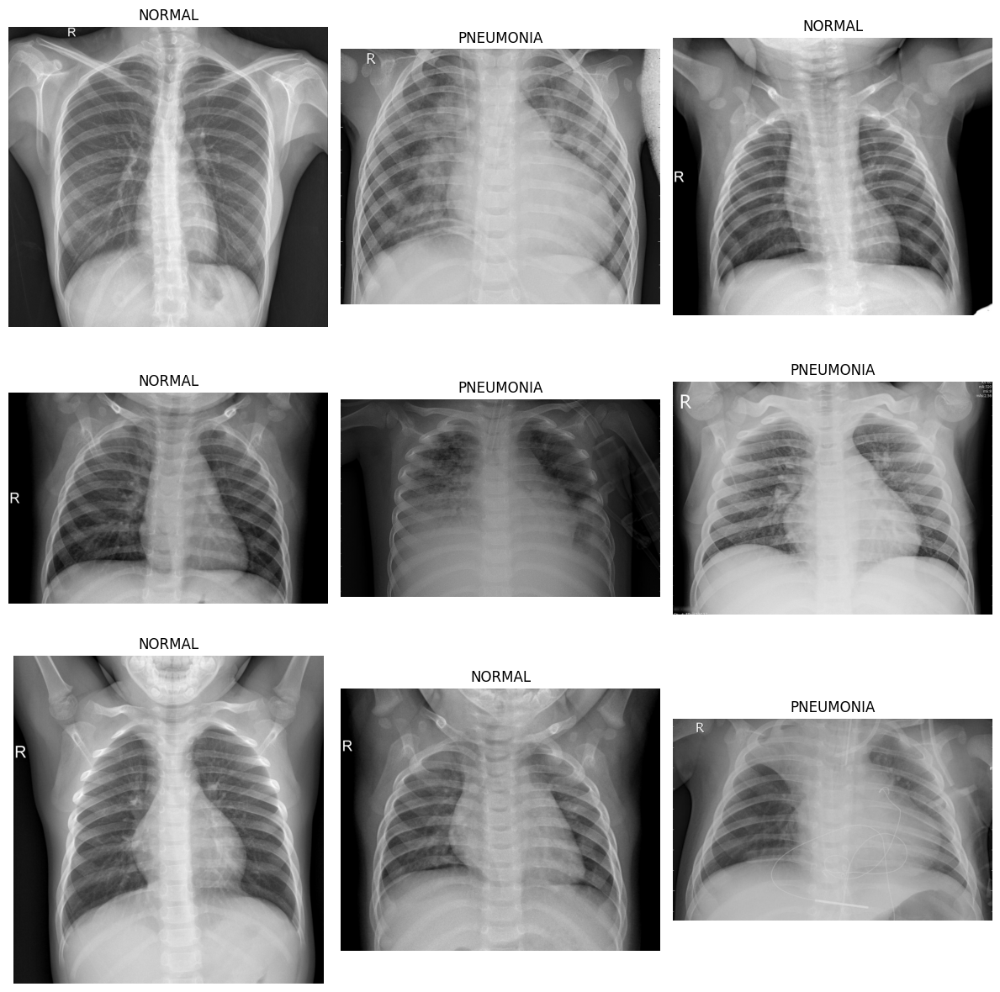

In [ ]:
import random
import cv2
import matplotlib.pyplot as plt

# Rastgele seçim için seed ayarı
random.seed(42)

# Görselleri rastgele seç
sampled_images = random.sample(pneumonia_images, 4) + random.sample(normal_images, 5)
random.shuffle(sampled_images)

# Seçilen görüntüleri yazdır
print("Seçilen Görüntüler:")
for img_path in sampled_images:
    print(img_path)

# Görselleştirme
fig, axes = plt.subplots(3, 3, figsize=(12, 12))

for i, ax in enumerate(axes.flatten()):
    img_path = sampled_images[i]
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    category = "PNEUMONIA" if "PNEUMONIA" in img_path else "NORMAL"

    # Görseli çizdir
    ax.imshow(img, cmap='gray')
    ax.set_title(category, fontsize=12)
    ax.axis("off")

plt.tight_layout()
plt.show()

# 3. Görüntü İşleme ve İyileştirme (Pre-processing)
1.	Görüntüleri Akciğer bölgeleri kaybolmayacak şekilde kenarlardan kırpın (Crop),(ilgi alanı dışındaki gürültü bölgelerinden kurtulun
o	Orijinal ve Crop edilmiş görüntüleri görseleştirin.
2.	Arasınav ödevi çıktılarını inceleyerek Kontrast Germe (Stretching) Histogram Eşitleme (Equalization) yöntemlerinden uygun gördüğünüzü crop edilmiş görüntüye uygulayın. (YORUM)
o	Crop edilmişve dönüşüme uğramış  görüntüleri görseleştirin.

3.	Bir önceki adımın çıktısına gürültü azaltma işlemlerinden birini seçerek uygulayın (örn: Median ve Gaussian Blur).
o	Görüntüleri görseleştirin


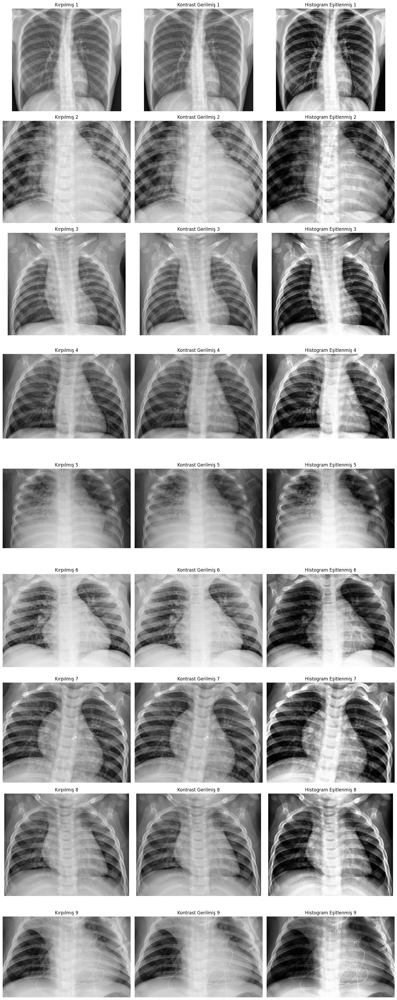

In [ ]:
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt

# Görüntüyü kırpma fonksiyonu
def crop_image(image):
    height, width = image.shape
    return image[int(height * 0.1):int(height * 0.9), int(width * 0.1):int(width * 0.9)]

# Görüntüleri yükleyip kırpma işlemi
original_cropped_pairs = []
for img_path in sample_images:
    image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    cropped = crop_image(image)
    original_cropped_pairs.append((image, cropped))

# Kontrast Germe Fonksiyonu
def apply_contrast_stretching(image):
    min_val, max_val = np.min(image), np.max(image)
    stretched = ((image - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return stretched

# Histogram Eşitleme Fonksiyonu
def apply_histogram_equalization(image):
    return cv2.equalizeHist(image)

# Kontrast Germe ve Histogram Eşitleme uygulanmış görüntüleri oluştur
processed_images = []
for orig, cropped in original_cropped_pairs:
    stretched = apply_contrast_stretching(cropped)
    equalized = apply_histogram_equalization(cropped)
    processed_images.append((cropped, stretched, equalized))

# Görselleştirme
fig, axes = plt.subplots(len(processed_images), 3, figsize=(15, 38))

for i, (cropped, stretched, equalized) in enumerate(processed_images):
    axes[i, 0].imshow(cropped, cmap='gray')
    axes[i, 0].set_title(f"Kırpılmış {i+1}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(stretched, cmap='gray')
    axes[i, 1].set_title(f"Kontrast Gerilmiş {i+1}")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(equalized, cmap='gray')
    axes[i, 2].set_title(f"Histogram Eşitlenmiş {i+1}")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()

# Yorumlama
1. Kırpılmış Görüntüler (Kırpılmış 1 - Kırpılmış 9)
* Bu sütundaki görüntüler, orijinal röntgenlerin belirli bir bölgesinin kırpılmış hali.
* Odaklanmak istenilen bölgeyi vurgulamak. Özellikle akciğer bölgesi daha iyi analiz edilebilmesi için çerçevelenmiş.
* Kenar kısımlardaki gereksiz bilgiler elendiği için model veya doktorun dikkatini ilgili bölgeye çekebilir.
2. Kontrast Gerilmiş Görüntüler (Kontrast Gerilmiş 1 - Kontrast Gerilmiş 9)
* Görüntülerin en düşük ve en yüksek parlaklık değerleri yeniden ölçeklendirilerek kontrast artırılmış.
* Görüntüdeki detayları daha görünür hale getirmek, özellikle akciğer dokusundaki farklılıkları netleştirmek.
* Görseller genel olarak daha keskin görünüyor.
Akciğerin içindeki damar yapıları daha belirgin olmuş.
Koyu bölgeler daha koyu, açık bölgeler daha açık hale gelmiş, böylece farklı yapılar arasındaki kontrast güçlendirilmiş.
Ancak, bazı durumlarda gereksiz gürültüyü artırabilir.
3. Histogram Eşitlenmiş Görüntüler (Histogram Eşitlenmiş 1 - Histogram Eşitlenmiş 9)
* Histogram eşitleme işlemiyle, görüntüdeki parlaklık değerleri daha dengeli hale getirilmiş.
* Görüntüdeki kontrastı artırarak koyu ve açık alanların daha iyi dağıtılmasını sağlamak.
* Görüntüler bazılarında biraz daha fazla detay ortaya çıkmış.
Akciğerin içindeki hava boşlukları ile dokular arasındaki fark daha belirgin.
Ancak aşırı kontrast nedeniyle bazı alanlarda çok parlak veya çok koyu bölgeler oluşmuş olabilir.
Özellikle düşük kontrastlı röntgenlerde (örneğin, pnömoni olan hastalarda akciğer dokusu genellikle daha homojen görünür), bu yöntem anormallikleri daha görünür hale getirebilir.


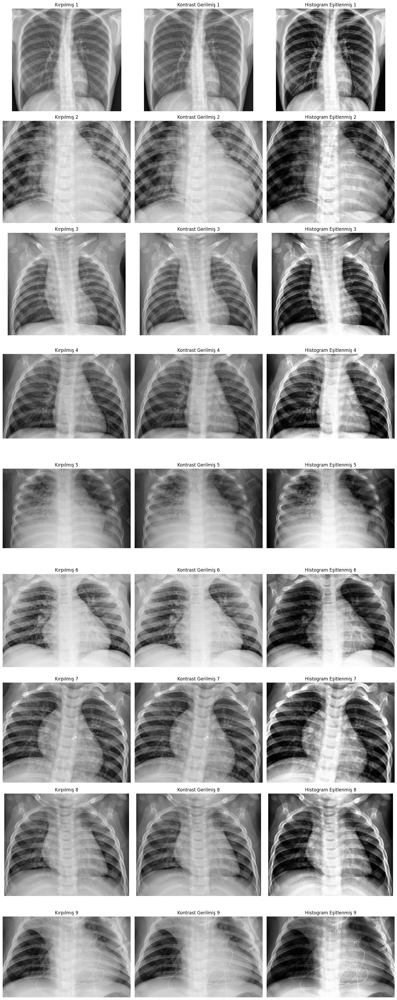

In [ ]:
# Kontrast Germe Fonksiyonu
def apply_contrast_stretching(image):
    min_val, max_val = np.min(image), np.max(image)
    stretched = ((image - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return stretched

# Histogram Eşitleme Fonksiyonu
def apply_histogram_equalization(image):
    return cv2.equalizeHist(image)

# Kontrast Germe ve Histogram Eşitleme uygulanmış görüntüleri oluştur
processed_images = []
for _, cropped in original_cropped_pairs:
    stretched = apply_contrast_stretching(cropped)
    equalized = apply_histogram_equalization(cropped)
    processed_images.append((cropped, stretched, equalized))

# Görselleştirme
fig, axes = plt.subplots(len(processed_images), 3, figsize=(15, 38))

for i, (cropped, stretched, equalized) in enumerate(processed_images):
    axes[i, 0].imshow(cropped, cmap='gray')
    axes[i, 0].set_title(f"Kırpılmış {i+1}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(stretched, cmap='gray')
    axes[i, 1].set_title(f"Kontrast Gerilmiş {i+1}")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(equalized, cmap='gray')
    axes[i, 2].set_title(f"Histogram Eşitlenmiş {i+1}")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()


1.	Temiz akciğer yapısı, normal kontrast	Akciğerin iç detayları netleşmiş	Daha yüksek kontrast, koyu bölgeler vurgulanmış
2.	Hafif bulanık, kaburga yapıları görülüyor	Kontrast artışı ile damar yapıları daha net	Daha keskin ancak biraz fazla kontrastlı
3.	Belirgin akciğer detayları, kırpılmış	Daha parlak ve belirgin, gri tonlar daha dengeli	Daha koyu alanlar belirginleşmiş
4.	Akciğer iç yapıları orta derecede görünür	Daha yüksek kontrast, damar yapıları daha net	Kontrast artışı nedeniyle bazı alanlar aşırı parlak
5.	Hafif soluk görüntü	Akciğerlerin hava boşlukları netleşmiş	Yüksek kontrast ile gölgeler artmış
6.	Detaylar düşük seviyede, bulanık noktalar var	Keskinleşmiş ve kontrast dengelenmiş	Fazla koyulaşmış ancak detaylar ortaya çıkmış
7.	Normal parlaklık, simetrik göğüs yapısı	Daha net damar ve bronş yapıları	Açık ve koyu alanlar arasındaki fark çok belirgin
8.	Daha az kontrast, bazı bölgeler soluk	Akciğer içindeki yapılar daha net	Aşırı kontrast nedeniyle bazı parlak bölgeler kaybolmuş
9.	Göğüste kablolar (muhtemelen bir tıbbi cihaz) görünüyor	Kablolar daha belirgin hale gelmiş	Yüksek kontrast nedeniyle detaylar biraz kaybolmuş

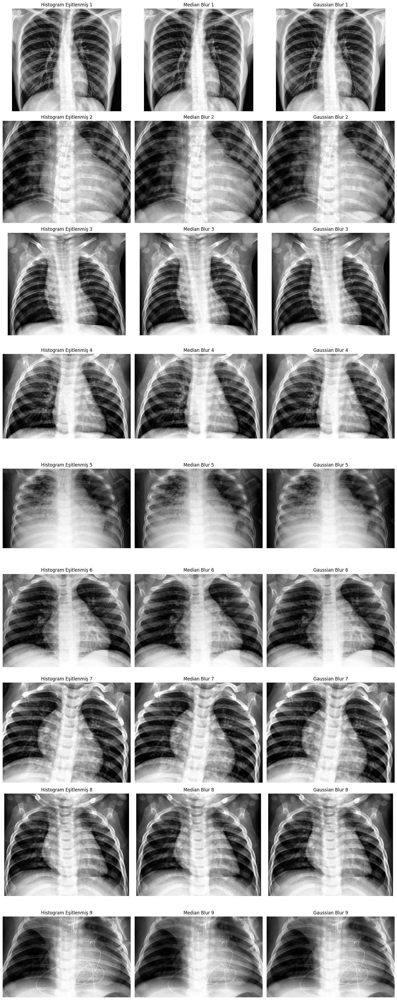

In [ ]:
# Median Blur Fonksiyonu
def apply_median_blur(image, kernel_size=5):
    return cv2.medianBlur(image, kernel_size)

# Gaussian Blur Fonksiyonu
def apply_gaussian_blur(image, kernel_size=5):
    return cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)

# Gürültü azaltma işlemleri
filtered_images = []
for _, _, equalized in processed_images:
    median_filtered = apply_median_blur(equalized)
    gaussian_filtered = apply_gaussian_blur(equalized)
    filtered_images.append((equalized, median_filtered, gaussian_filtered))

# Görselleştirme
fig, axes = plt.subplots(len(filtered_images), 3, figsize=(15, 38))

for i, (equalized, median_filtered, gaussian_filtered) in enumerate(filtered_images):
    axes[i, 0].imshow(equalized, cmap='gray')
    axes[i, 0].set_title(f"Histogram Eşitlenmiş {i+1}")
    axes[i, 0].axis("off")

    axes[i, 1].imshow(median_filtered, cmap='gray')
    axes[i, 1].set_title(f"Median Blur {i+1}")
    axes[i, 1].axis("off")

    axes[i, 2].imshow(gaussian_filtered, cmap='gray')
    axes[i, 2].set_title(f"Gaussian Blur {i+1}")
    axes[i, 2].axis("off")

plt.tight_layout()
plt.show()

1.	Kontrast yüksek, damar yapıları net	Gürültü azalmış, kenarlar korunmuş	Daha yumuşak, detaylar biraz kaybolmuş
2.	Kemik yapıları belirgin, kontrast dengesi artmış	Gürültü temizlenmiş, detaylar yumuşatılmış	Daha bulanık bir yapı oluşmuş
3.	Damar ve bronş detayları net	Hafif bulanık ancak keskin kenarlar korunmuş	Daha pürüzsüz ancak detay kaybı var
4.	Kontrast yüksek, bazı alanlar aşırı koyu	Gürültü temizlenmiş, akciğer iç detayları hafif yumuşatılmış	Keskinlik azalırken daha yumuşak bir görünüm oluşmuş
5.	Yoğun bölgelerde kontrast artışı var	Gürültü azaltılmış, ancak bazı küçük detaylar kaybolmuş	Genel görünüm daha düzleşmiş, ama netlik azalmış
6.	Akciğer içindeki lekeler netleşmiş	Gürültü azaltılmış, ancak detaylar biraz bulanık	Daha fazla yumuşaklık, bazı detaylar kaybolmuş
7.	Kontrast yoğun, bazı bölgelerde aşırı parlaklık var	Yumuşatılmış ancak önemli detaylar hala korunmuş	Görüntü en pürüzsüz hale getirilmiş ancak detaylar azalmış
8.	Kaburgalar ve akciğer içindeki detaylar netleşmiş	Kenarlar korunarak bulanıklaştırılmış	Daha fazla yumuşaklık, ancak detaylar biraz azalmış
9.	Yoğun bakım hastasında kablolar net olarak görülebiliyor	Kabloların çevresi yumuşatılmış	Kabloların keskinliği azalmış ancak daha pürüzsüz bir görüntü elde edilmiş

# 4.	Eşik sayısı belirleme

o	Tek eşik değeri kullanacaksanız, Görüntülere Gauss yoğunluk dönüşümü gibi akciğer yoğunluk değerleri ile düşük ve yüksek değerleri ayıracak bir transform uygulayınız.

 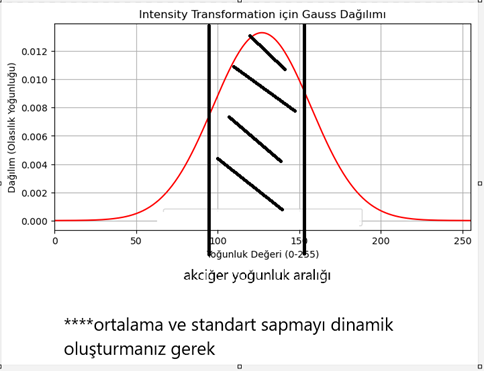

o	Dönüşüm uygulanmayacaksa optimum eşik sayısı belirlenmeli bunu dikkate alın. (örnek1: eşik sayısı 2 bölge sayısı 3 (alt-orta-üst)  orta=1, else=0, örnek2:esik sayısı 5, bölge sayısı 6 (a1-a2-o1-o2-u1-u2) o1&o2=1, else=0)


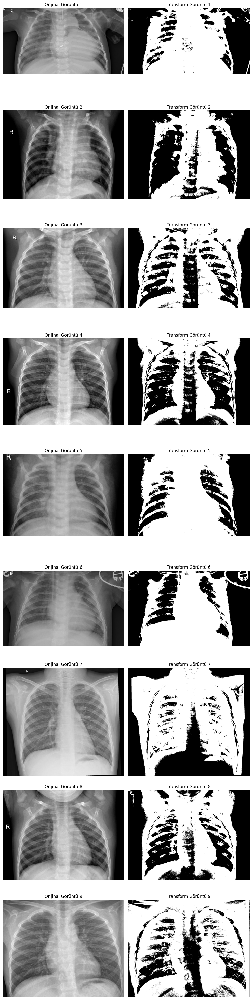

In [ ]:
# Sabit eşik değerleri
thresholds = [0, 50, 100, 150, 200, 255]

def threshold_segmentation(image, thresholds):
    segmented_image = np.zeros_like(image, dtype=np.uint8)

    # Bölgelere ayırma işlemi
    for i in range(1, len(thresholds) - 1):
        lower = thresholds[i]
        upper = thresholds[i + 1]

        if i == 2 or i == 3:  # o1 ve o2 bölgeleri için
            segmented_image[(image >= lower) & (image < upper)] = 1
        else:
            segmented_image[(image >= lower) & (image < upper)] = 0

    return segmented_image

# 9 farklı görseli işleme
fig, axes = plt.subplots(9, 2, figsize=(10, 40))

for idx, image_path in enumerate(sampled_images[:9]):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    transformed_image = threshold_segmentation(original_image, thresholds)

    # Görselleştirme
    axes[idx, 0].imshow(original_image, cmap='gray')
    axes[idx, 0].set_title(f'Orijinal Görüntü {idx+1}')
    axes[idx, 0].axis('off')

    axes[idx, 1].imshow(transformed_image, cmap='gray')
    axes[idx, 1].set_title(f'Transform Görüntü {idx+1}')
    axes[idx, 1].axis('off')

plt.tight_layout()
plt.show()

1.	Kemik ve yumuşak doku net ayrılmış, yoğun siyah-beyaz ayrımı var
2.	Damar yapıları ve kemikler daha keskin şekilde ayrılmış
3.	Yüksek kontrastlı, iç dokular belirgin ancak bazı detaylar kaybolmuş
4.	Kaburga ve bronş yapıları öne çıkarılmış, bazı bölgeler fazla beyaz
5.	Akciğer dokusu ile göğüs duvarı arasındaki fark artırılmış
6.	Ekipman bölgeleri daha net hale gelmiş, kemikler siyah-beyaz olarak belirgin
7.	Akciğer dokusundaki koyu alanlar belirginleşmiş
8.	Yüksek kontrastla kaburgalar ve iç dokular keskinleştirilmiş
9.	Akciğer içindeki yapılar ayrıştırılmış, kontrast çok yüksek

# 4. Thresholding
1.	Global Thresholding, Otsu veya skimage all filter kütüphanesini kullanarak (from skimage.filters import try_all_threshold) https://scikit-image.org/docs/dev/auto_examples/segmentation/plot_thresholding.html en az 2 thresholding yöntemi  ile eşik değerlerini belirleyiniz.
2.	Eşik değerlerini görüntülere uygulayarak binary görüntüleri görselleştirip uygun thresholding yöntemini i seçiniz. (YORUM)


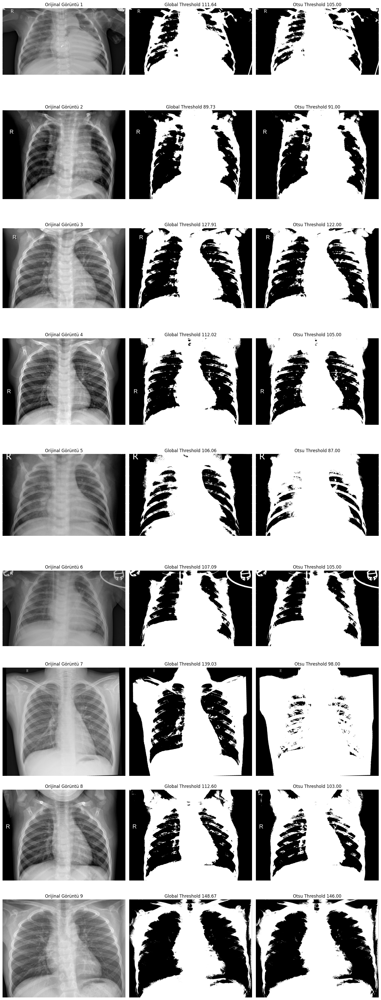

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu, threshold_mean

def apply_thresholds(image):
    global_thresh = threshold_mean(image)
    binary_global = image > global_thresh

    otsu_thresh = threshold_otsu(image)
    binary_otsu = image > otsu_thresh

    return binary_global, binary_otsu, global_thresh, otsu_thresh

def plot_images(images, num_samples=9):
    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 40))

    for idx, image_path in enumerate(images[:num_samples]):
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        binary_global, binary_otsu, global_thresh, otsu_thresh = apply_thresholds(image)

        axes[idx, 0].imshow(image, cmap='gray')
        axes[idx, 0].set_title(f'Orijinal Görüntü {idx+1}')
        axes[idx, 0].axis('off')

        axes[idx, 1].imshow(binary_global, cmap='gray')
        axes[idx, 1].set_title(f'Global Threshold {global_thresh:.2f}')
        axes[idx, 1].axis('off')

        axes[idx, 2].imshow(binary_otsu, cmap='gray')
        axes[idx, 2].set_title(f'Otsu Threshold {otsu_thresh:.2f}')
        axes[idx, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Örnek görüntüleri işleyelim
plot_images(sampled_images)

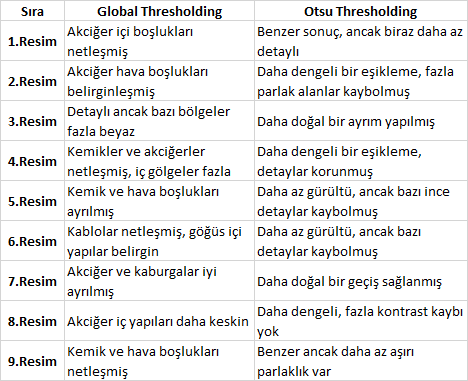


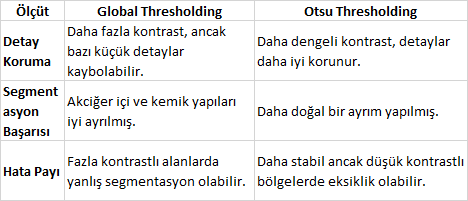

# 5. Post-processing
1.	Uygun morfolojik operatörleri, uygun structural element yapısı ve boyutunu seçerek görüntüye uygulayınız. (YORUM)
o	Giriş ve Çıkış Görüntülerini görseleştirin
.
2.	Görüntüye bağlantı bileşen analizi (connected component labeling-CCL) (cv2.connectedComponents) uygulayarak olası bölge sayısını print CCL çıktısını plot edin.

3.	Elde ettiğiniz labellar için, Centroid ve Area bilgilerinin kesinlikle olacağı, ayrıca bölgelerin yoğunluk ve şekilsel özelliklerini belirten en az 5 tane özniteliği print edin.
o	(cv2.connectedComponentsWithStats önerebilirim ama scikit-image’ın regionprops u daha iyi)
4.	Elde ettiğiniz stats ve labelsları inceleyerek akciğer alanlarını en iyi ifade eden öznitelikleri yorumlayınız.
o	Belirlediğniz özniteliklere göre filtreleme yapın. (örn: maks alana sahip ilk iki bölge, if maks alana sahip iki bölge and bölgelerin centroidleri ortada; filter; else try 3. Bölge; return)
o	Belirleyici öznitelik bulunamadıysa. Her görüntüde otomatik olarak label belirleyen algoritmayı yazın

5.	Seçtiğiniz labela sahip filtrelenmiş görüntülere uygun morfolojik işlemleri (structural elemant tipi ve boyutu belirleyerek) uygulayın. Giriş ve çıkış görüntülerini görselleştirin.



In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu
from skimage.measure import regionprops


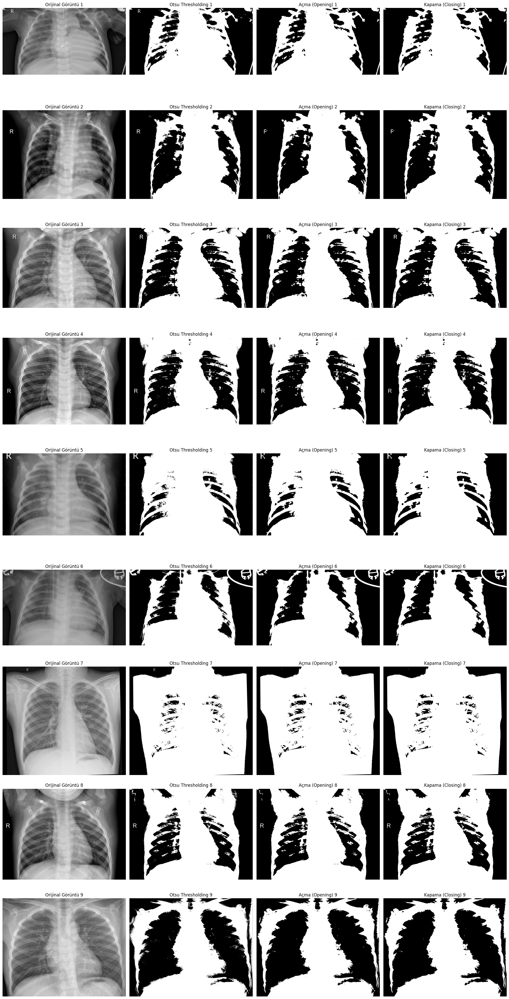

In [ ]:
def process_image(image_path, kernel_size=(5, 5)):
    """
    Görseli işleyerek Otsu thresholding ve morfolojik işlemleri uygular.
    """
    # Görseli gri tonlamaya çevirme
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Otsu Thresholding
    otsu_thresh = threshold_otsu(image)
    binary_image = image > otsu_thresh

    # Kernel tanımlama
    kernel = np.ones(kernel_size, np.uint8)

    # Açma ve Kapama işlemleri
    opened = cv2.morphologyEx(binary_image.astype(np.uint8), cv2.MORPH_OPEN, kernel)
    closed = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, kernel)

    return image, binary_image, opened, closed

def visualize_results(image_paths, num_images=9):
    """
    İşlenmiş görselleri görselleştirir.
    """
    fig, axes = plt.subplots(num_images, 4, figsize=(20, 40))

    for idx, image_path in enumerate(image_paths[:num_images]):
        original, binary, opened, closed = process_image(image_path)

        titles = ['Orijinal Görüntü', 'Otsu Thresholding', 'Açma (Opening)', 'Kapama (Closing)']
        images = [original, binary, opened, closed]

        for col, (img, title) in enumerate(zip(images, titles)):
            axes[idx, col].imshow(img, cmap='gray')
            axes[idx, col].set_title(f'{title} {idx + 1}')
            axes[idx, col].axis('off')

    plt.tight_layout()
    plt.show()

# Örnek görsellerin işlenmesi
visualize_results(sampled_images)

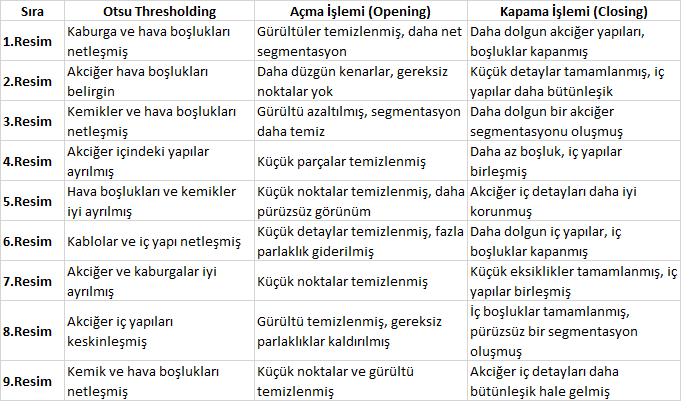

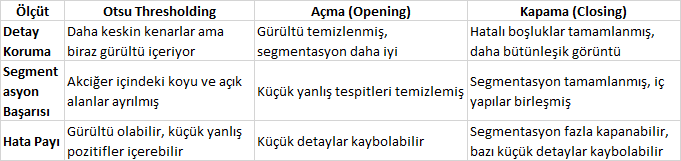

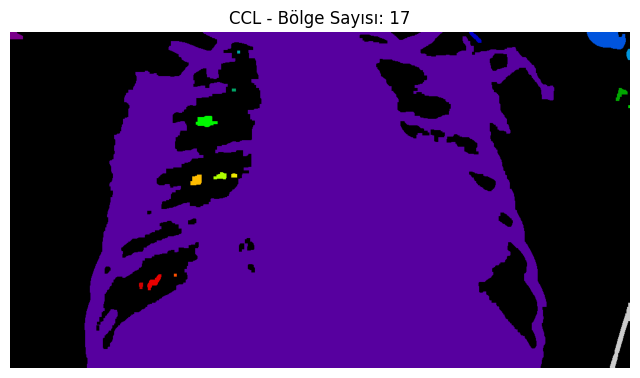


Bölge Sayısı: 17
Image 1 Region Data:
Label: 1, Centroid: (7.42741935483871, 8.887096774193548), Area: 248.0, Eccentricity: 0.8145104462977393, Solidity: 0.9393939393939394, Mean Intensity: 202.90725806451613, Orientation: 1.2571203227483545

Label: 2, Centroid: (311.7259478875998, 527.0650578890684), Area: 326832.0, Eccentricity: 0.5689837399639266, Solidity: 0.782546234664266, Mean Intensity: 154.20500440593332, Orientation: -1.4440675077332614

Label: 3, Centroid: (9.542372881355933, 786.1355932203389), Area: 177.0, Eccentricity: 0.965022509048751, Solidity: 0.9076923076923077, Mean Intensity: 121.05649717514125, Orientation: 0.8026471127379189

Label: 4, Centroid: (13.386683738796416, 1009.2880921895006), Area: 1562.0, Eccentricity: 0.9004812769009525, Solidity: 0.9432367149758454, Mean Intensity: 194.68245838668375, Orientation: 1.3851244921813357

Label: 5, Centroid: (38.95789473684211, 1044.8947368421052), Area: 95.0, Eccentricity: 0.9485721480930615, Solidity: 0.95959595959595

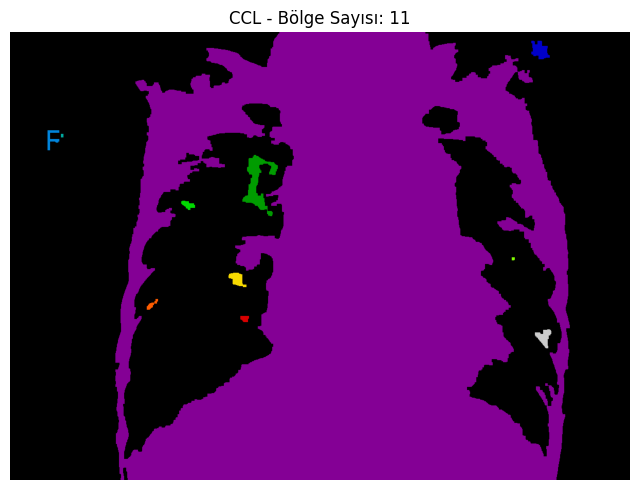


Bölge Sayısı: 11
Image 2 Region Data:
Label: 1, Centroid: (464.04332775211316, 673.164789897319), Area: 495710.0, Eccentricity: 0.5976792290635757, Solidity: 0.6909649478615645, Mean Intensity: 153.76789050049425, Orientation: -0.012837200223005711

Label: 2, Centroid: (35.246207701283545, 1030.2462077012835), Area: 857.0, Eccentricity: 0.7083975826999617, Solidity: 0.8016838166510758, Mean Intensity: 97.4830805134189, Orientation: 0.7197577912017337

Label: 3, Centroid: (206.13471502590673, 80.81088082901555), Area: 386.0, Eccentricity: 0.810978094799877, Solidity: 0.5237449118046132, Mean Intensity: 252.52072538860102, Orientation: -0.2789788969528911

Label: 4, Centroid: (201.0, 101.0), Area: 35.0, Eccentricity: 0.7071067811865476, Solidity: 1.0, Mean Intensity: 250.77142857142857, Orientation: 0.0

Label: 5, Centroid: (291.94692144373676, 481.5265392781316), Area: 2826.0, Eccentricity: 0.8898625993109439, Solidity: 0.46857900845630907, Mean Intensity: 106.49433828733191, Orientati

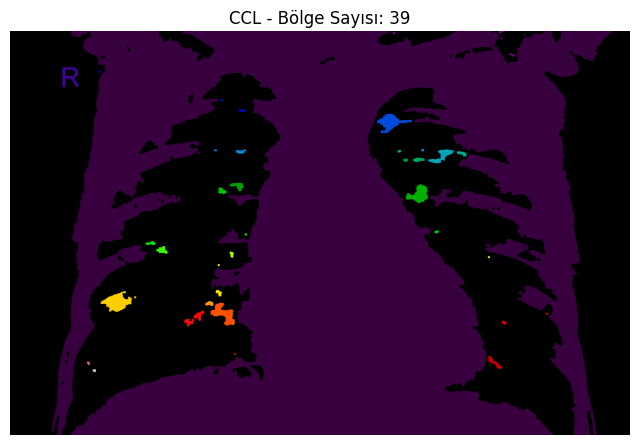


Bölge Sayısı: 39
Image 3 Region Data:
Label: 1, Centroid: (501.07506710608465, 820.5233627937765), Area: 850519.0, Eccentricity: 0.41467509745798903, Solidity: 0.6147798298894144, Mean Intensity: 171.55869416203518, Orientation: -1.4830357585253238

Label: 2, Centroid: (1.875, 1233.9107142857142), Area: 56.0, Eccentricity: 0.9262569129486109, Solidity: 0.8615384615384616, Mean Intensity: 125.44642857142857, Orientation: -1.3725429049376052

Label: 3, Centroid: (5.0, 964.5), Area: 30.0, Eccentricity: 0.560611910581388, Solidity: 1.0, Mean Intensity: 125.5, Orientation: 1.5707963267948966

Label: 4, Centroid: (59.63157894736842, 1261.5263157894738), Area: 57.0, Eccentricity: 0.928280132039697, Solidity: 0.76, Mean Intensity: 125.66666666666667, Orientation: 1.1528692987715343

Label: 5, Centroid: (112.73375262054508, 149.4056603773585), Area: 954.0, Eccentricity: 0.4281633201875567, Solidity: 0.49149922720247297, Mean Intensity: 250.41928721174006, Orientation: 0.10665091651019436

Labe

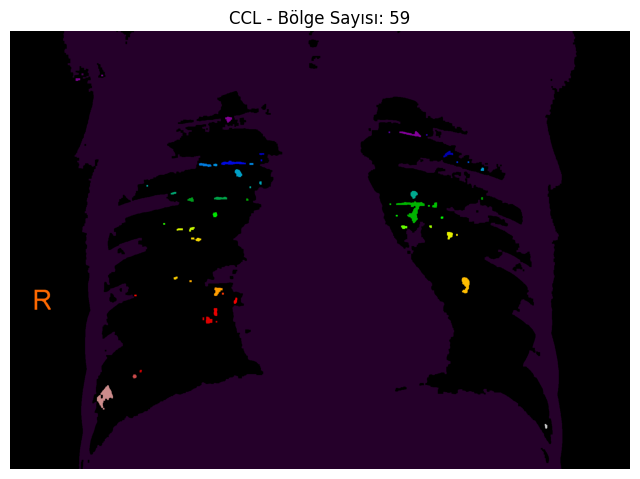


Bölge Sayısı: 59
Image 4 Region Data:
Label: 1, Centroid: (645.0183180817384, 965.8323358310085), Area: 1360732.0, Eccentricity: 0.3299983713068394, Solidity: 0.6711967807777945, Mean Intensity: 167.1703281763051, Orientation: 0.22860881579838674

Label: 2, Centroid: (131.5, 220.5), Area: 36.0, Eccentricity: 0.0, Solidity: 1.0, Mean Intensity: 109.58333333333333, Orientation: -0.7853981633974483

Label: 3, Centroid: (135.0, 280.5), Area: 30.0, Eccentricity: 0.560611910581388, Solidity: 1.0, Mean Intensity: 110.3, Orientation: 1.5707963267948966

Label: 4, Centroid: (147.14, 206.02), Area: 100.0, Eccentricity: 0.8503904055243742, Solidity: 0.9523809523809523, Mean Intensity: 106.67, Orientation: -1.4288992721907328

Label: 5, Centroid: (268.1673469387755, 665.9551020408163), Area: 245.0, Eccentricity: 0.5241486429651597, Solidity: 0.8718861209964412, Mean Intensity: 114.23673469387755, Orientation: -1.4561900507805094

Label: 6, Centroid: (313.0689655172414, 1223.7241379310344), Area: 

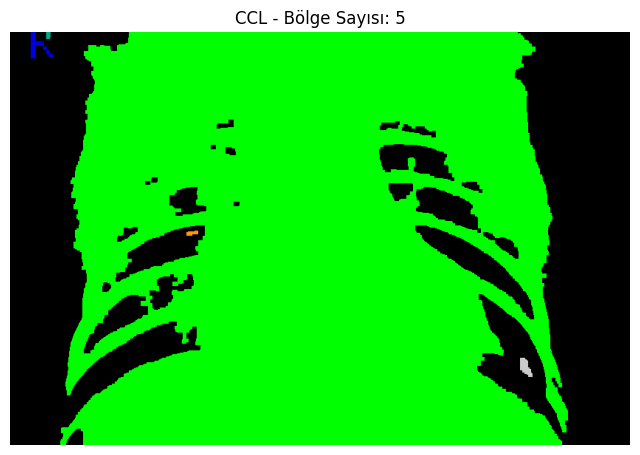


Bölge Sayısı: 5
Image 5 Region Data:
Label: 1, Centroid: (19.975675675675674, 36.75405405405405), Area: 370.0, Eccentricity: 0.7680435125735343, Solidity: 0.505464480874317, Mean Intensity: 252.2864864864865, Orientation: 0.6800209359897801

Label: 2, Centroid: (4.859375, 51.421875), Area: 64.0, Eccentricity: 0.8436826410636641, Solidity: 0.9846153846153847, Mean Intensity: 247.078125, Orientation: -0.05276332545454703

Label: 3, Centroid: (279.777714645054, 405.91140634526437), Area: 313273.0, Eccentricity: 0.34318783268323166, Solidity: 0.8565667115995089, Mean Intensity: 139.8772476402371, Orientation: 1.3898330164204542

Label: 4, Centroid: (272.96385542168673, 246.2289156626506), Area: 83.0, Eccentricity: 0.9458900750535935, Solidity: 0.8645833333333334, Mean Intensity: 94.53012048192771, Orientation: -1.3993265432604864

Label: 5, Centroid: (454.36162361623616, 697.859778597786), Area: 271.0, Eccentricity: 0.9044725799231164, Solidity: 0.8885245901639345, Mean Intensity: 96.5424

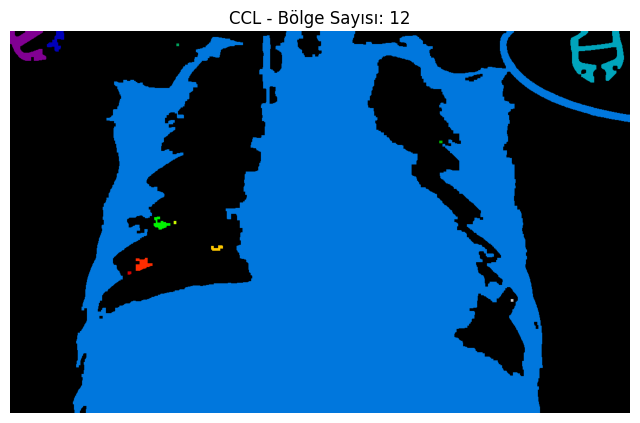


Bölge Sayısı: 12
Image 6 Region Data:
Label: 1, Centroid: (26.54994903160041, 29.587665647298675), Area: 1962.0, Eccentricity: 0.6787661619905969, Solidity: 0.6140845070422535, Mean Intensity: 159.62487257900102, Orientation: 0.8112570000267983

Label: 2, Centroid: (17.88550983899821, 85.89266547406082), Area: 559.0, Eccentricity: 0.8576788345337713, Solidity: 0.6726835138387485, Mean Intensity: 176.12343470483006, Orientation: -0.4904088984260034

Label: 3, Centroid: (410.85045072848277, 577.4620900262323), Area: 401794.0, Eccentricity: 0.5586832156954269, Solidity: 0.6415708341184098, Mean Intensity: 146.48587335798942, Orientation: -1.219468264696849

Label: 4, Centroid: (47.10381953345296, 1082.110484491156), Area: 3901.0, Eccentricity: 0.604271318232707, Solidity: 0.49137170928328505, Mean Intensity: 167.3394001538067, Orientation: -1.5399050804085768

Label: 5, Centroid: (25.0, 309.0), Area: 25.0, Eccentricity: 0.0, Solidity: 1.0, Mean Intensity: 108.6, Orientation: -0.785398163

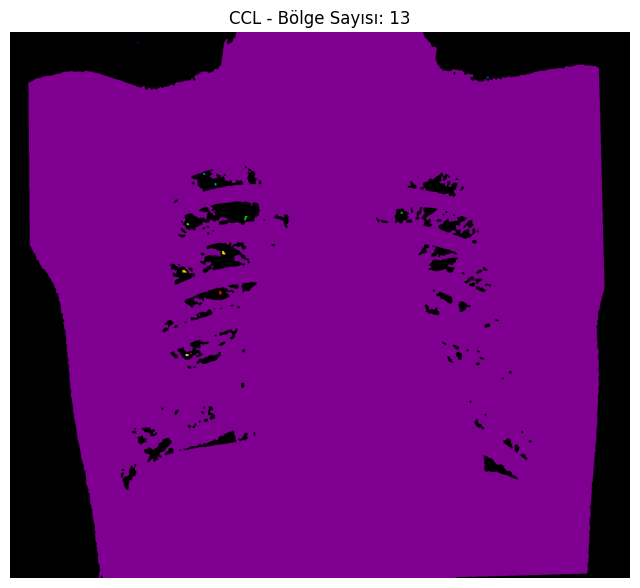


Bölge Sayısı: 13
Image 7 Region Data:
Label: 1, Centroid: (974.1559758263994, 1114.919443800429), Area: 3308237.0, Eccentricity: 0.3394387496302976, Solidity: 0.9322273085273808, Mean Intensity: 165.38775335624382, Orientation: 1.047080644345446

Label: 2, Centroid: (40.5, 447.0), Area: 40.0, Eccentricity: 0.7867957924694432, Solidity: 1.0, Mean Intensity: 250.35, Orientation: 0.0

Label: 3, Centroid: (161.61363636363637, 1667.590909090909), Area: 44.0, Eccentricity: 0.7239055397147233, Solidity: 0.9777777777777777, Mean Intensity: 99.6590909090909, Orientation: -1.3245740960552834

Label: 4, Centroid: (498.0, 677.5), Area: 40.0, Eccentricity: 0.7867957924694432, Solidity: 1.0, Mean Intensity: 103.2, Orientation: 1.5707963267948966

Label: 5, Centroid: (534.0, 717.5), Area: 52.0, Eccentricity: 0.753234717429019, Solidity: 1.0, Mean Intensity: 100.25, Orientation: 0.10759736353929059

Label: 6, Centroid: (633.327868852459, 1367.377049180328), Area: 61.0, Eccentricity: 0.414891046924630

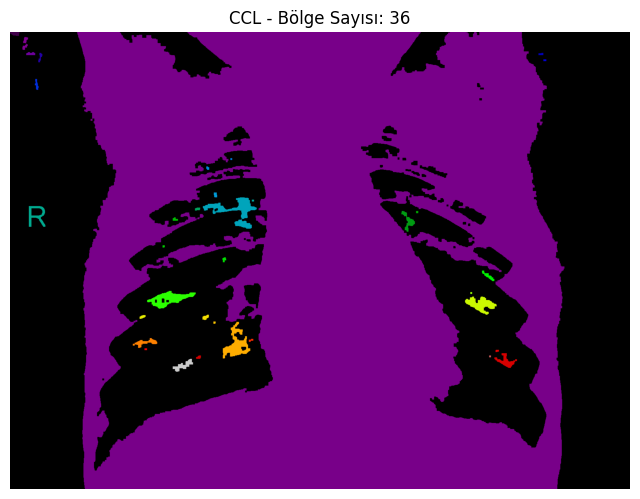


Bölge Sayısı: 36
Image 8 Region Data:
Label: 1, Centroid: (4.936026936026936, 13.993265993265993), Area: 297.0, Eccentricity: 0.8850179797559032, Solidity: 0.878698224852071, Mean Intensity: 113.10774410774411, Orientation: -1.569966267999099

Label: 2, Centroid: (594.6145234975387, 837.7994439919255), Area: 1129480.0, Eccentricity: 0.40168647529318596, Solidity: 0.7355894849545027, Mean Intensity: 159.8023586075008, Orientation: 0.2587496354004274

Label: 3, Centroid: (31.944444444444443, 39.81481481481482), Area: 270.0, Eccentricity: 0.9528561384598618, Solidity: 0.6733167082294265, Mean Intensity: 109.9, Orientation: -0.16044480446953302

Label: 4, Centroid: (60.0, 54.73170731707317), Area: 164.0, Eccentricity: 0.9503902862392077, Solidity: 0.9162011173184358, Mean Intensity: 112.4451219512195, Orientation: -1.55550001829062

Label: 5, Centroid: (69.38732394366197, 79.80985915492958), Area: 142.0, Eccentricity: 0.9663881506062303, Solidity: 0.7593582887700535, Mean Intensity: 108.3

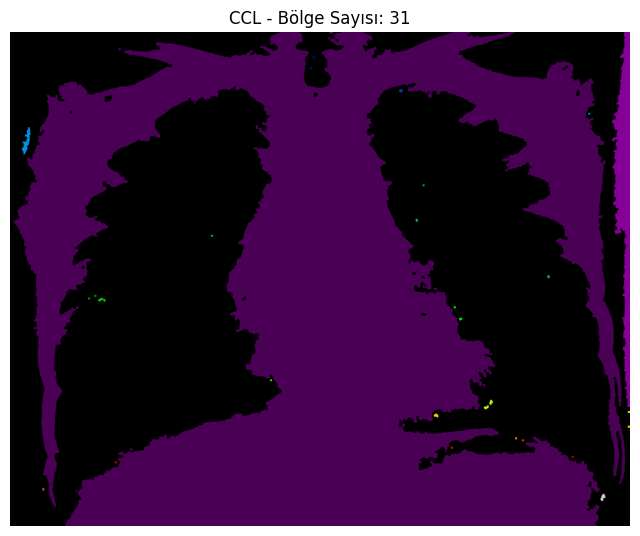


Bölge Sayısı: 31
Image 9 Region Data:
Label: 1, Centroid: (713.8794331014611, 850.0686175708714), Area: 1099456.0, Eccentricity: 0.2807219522843733, Solidity: 0.5469089577771378, Mean Intensity: 184.2509877612201, Orientation: 0.6725774661534532

Label: 2, Centroid: (2.4545454545454546, 862.5454545454545), Area: 77.0, Eccentricity: 0.8995607904592648, Solidity: 0.8651685393258427, Mean Intensity: 153.80519480519482, Orientation: -1.343607067861449

Label: 3, Centroid: (427.23479605959454, 1647.3205650085483), Area: 24566.0, Eccentricity: 0.999023897080282, Solidity: 0.7290046887055611, Mean Intensity: 159.80542212814458, Orientation: 0.011171270435091397

Label: 4, Centroid: (48.0, 293.0), Area: 35.0, Eccentricity: 0.7071067811865476, Solidity: 1.0, Mean Intensity: 153.37142857142857, Orientation: 1.5707963267948966

Label: 5, Centroid: (70.5, 814.5), Area: 36.0, Eccentricity: 0.0, Solidity: 1.0, Mean Intensity: 154.30555555555554, Orientation: -0.7853981633974483

Label: 6, Centroid:

In [ ]:
def apply_morphological_operations(image_path):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Otsu Thresholding
    otsu_thresh = threshold_otsu(original_image)
    binary_otsu = (original_image > otsu_thresh).astype(np.uint8)

    # Morfolojik Operatörler
    kernel = np.ones((5, 5), np.uint8)
    morph_open = cv2.morphologyEx(binary_otsu, cv2.MORPH_OPEN, kernel)
    morph_close = cv2.morphologyEx(morph_open, cv2.MORPH_CLOSE, kernel)

    return original_image, binary_otsu, morph_open, morph_close

def connected_components_analysis(morph_close, original_image):
    # Bağlantı Bileşen Analizi (CCL)
    num_labels, labels = cv2.connectedComponents(morph_close)

    # Görselleştirme
    plt.figure(figsize=(8, 8))
    plt.imshow(labels, cmap='nipy_spectral')
    plt.title(f'CCL - Bölge Sayısı: {num_labels - 1}')
    plt.axis('off')
    plt.show()

    print(f"\nBölge Sayısı: {num_labels - 1}")

    # RegionProperties kullanarak her bir bölgeyi analiz et
    regions = regionprops(labels, intensity_image=original_image)
    region_data = [
        {
            'label': region.label,
            'centroid': region.centroid,
            'area': region.area,
            'eccentricity': region.eccentricity,
            'solidity': region.solidity,
            'mean_intensity': region.mean_intensity,
            'orientation': region.orientation
        }
        for region in regions
    ]

    return num_labels, labels, region_data

# Örnek görseller için işlemi çalıştırma
for idx, image_path in enumerate(sampled_images[:9]):
    original_image, binary_otsu, morph_open, morph_close = apply_morphological_operations(image_path)

    # Bağlantı Bileşen Analizi ve RegionProperties
    num_labels, labels, region_data = connected_components_analysis(morph_close, original_image)

    # Her bir bölge verisini yazdır
    print(f"Image {idx + 1} Region Data:")
    for region in region_data:
        print(f"Label: {region['label']}, Centroid: {region['centroid']}, Area: {region['area']}, "
              f"Eccentricity: {region['eccentricity']}, Solidity: {region['solidity']}, "
              f"Mean Intensity: {region['mean_intensity']}, Orientation: {region['orientation']}\n")

# Segmentasyon Doğruluğu

* Otsu thresholding (eşikleme) yöntemi kullanılarak segmentasyon yapıldı.
* Otsu yöntemi genel olarak global bir eşik belirlediği için bazı görüntülerde kemik yapısını belirginleştirdiği ancak yumuşak dokuları tamamen kaybettiği gözlemleniyor.
* Bazı görüntülerde çok fazla küçük segmentler (gürültü) oluşmuş, bu da yanlış pozitif segmentlere sebep olabilir.
* Kapama (closing) morfolojik işlemi uygulanmış olmasına rağmen, bazı segmentlerde kesiklikler ve parçalanmalar görülüyor.

# Bölge Sayısı (CCL) ve Yapılar
* Bölge sayıları genellikle 10 ile 60 arasında değişmekte, ancak bazı görüntülerde 100’ün üzerinde küçük segmentlere rastlanıyor.
* Akciğer alanları genellikle iyi şekilde segment edilmiş ancak bazı durumlarda segmentlerin çok küçük parçalara ayrıldığı ve gürültülü olduğu gözlemleniyor.
* Bazı durumlarda bölge sayısı fazla olabilir, çünkü kemik yapıları ve diğer dokular ayrışmamış olabilir.

# Belirli Bölgelere Odaklanma
* Akciğer içi küçük opasiteler (lezyonlar, nodüller) belirginleşmiş olabilir ancak bazı durumlarda akciğer sınırları tamamen belirlenmemiş.
* Kemik yapılarının segmentasyonu bazı görüntülerde daha baskın, bu da yumuşak doku lezyonlarının net bir şekilde ayrılmasını zorlaştırıyor.
* Metal implant, sensör gibi nesnelerin belirginleştiği görüntüler var ve bunlar gürültü olarak değerlendirilmelidir.

-------------------------------

Segmentasyon yöntemi genel olarak başarılı, ancak bazı görüntülerde aşırı segmentasyon (fazla küçük parçalar) ve gürültü problemi var.
Bölge sayısı analizi, küçük segmentlerin gürültü olarak temizlenmesi gerektiğini gösteriyor.
Akciğer dokusu ve kemikler iyi ayrışmış, ancak yumuşak doku lezyonları gibi küçük yapılar kaybolabilir.

Seçilen Bölgeler: [2, 4]


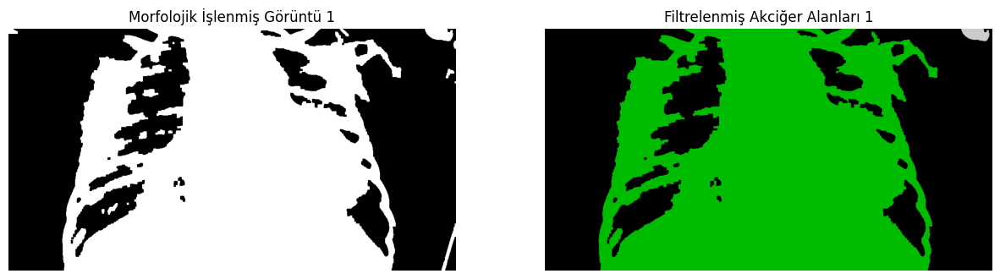

Seçilen Bölgeler: [1, 5]


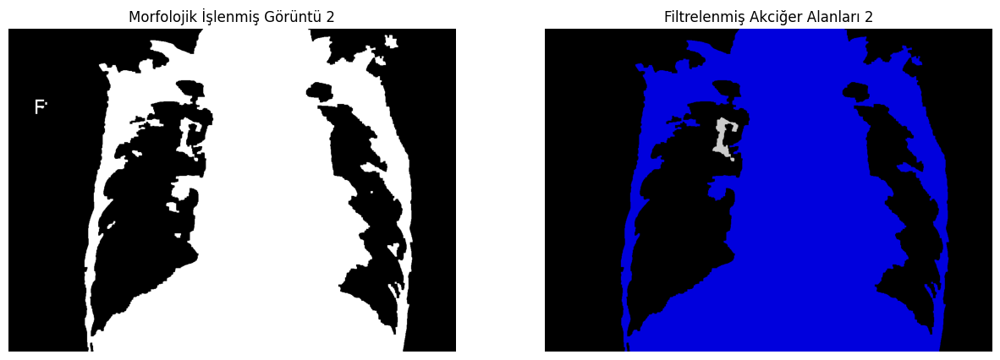

Seçilen Bölgeler: [1, 29]


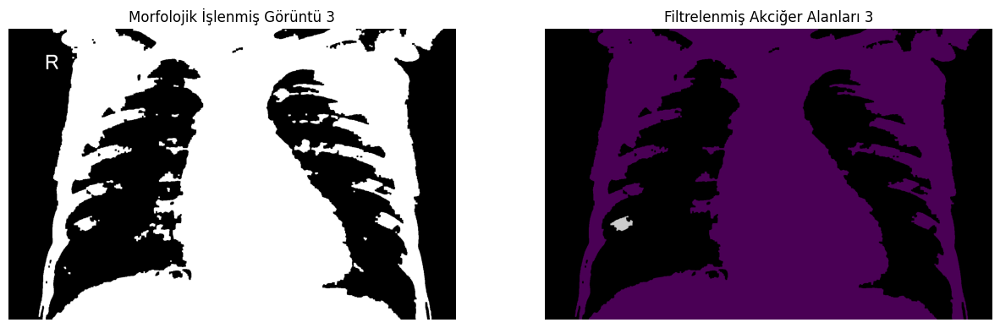

Seçilen Bölgeler: [1, 29]


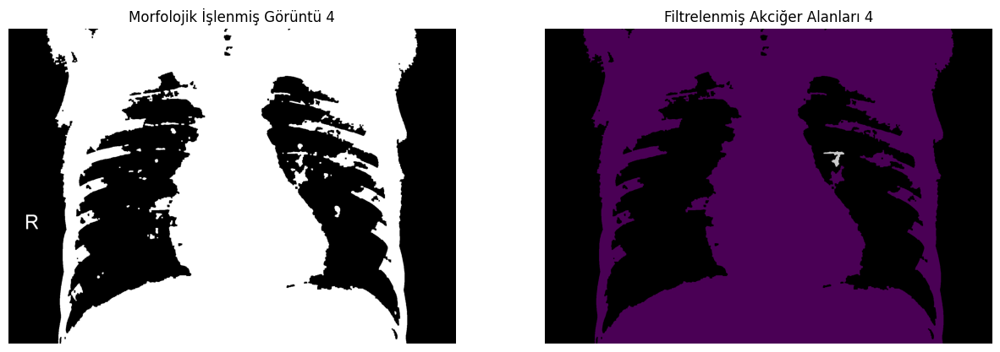

Seçilen Bölgeler: [3, 1]


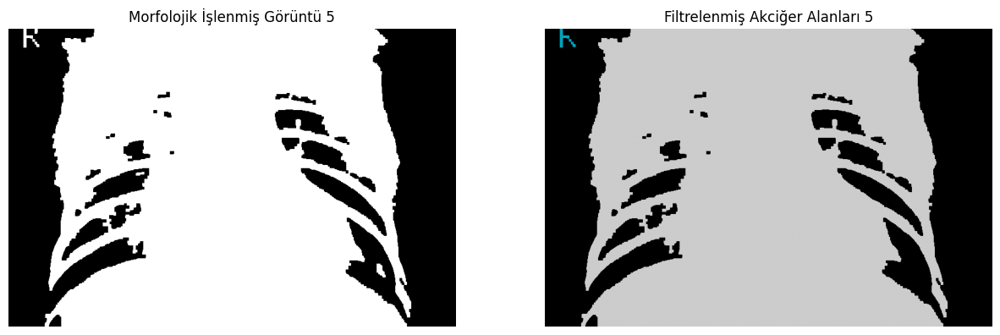

Seçilen Bölgeler: [3, 4]


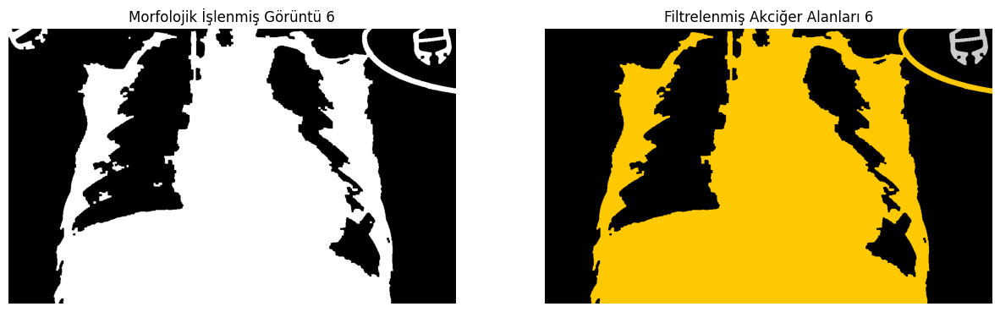

Seçilen Bölgeler: [1, 10]


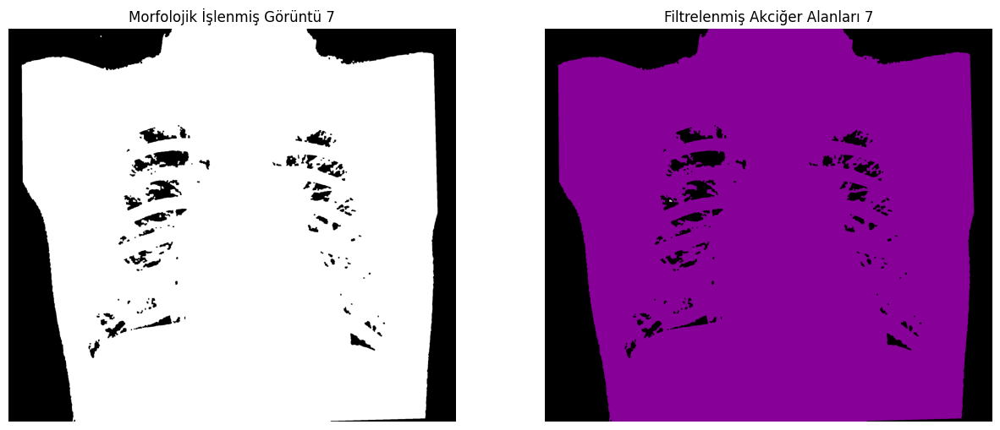

Seçilen Bölgeler: [2, 12]


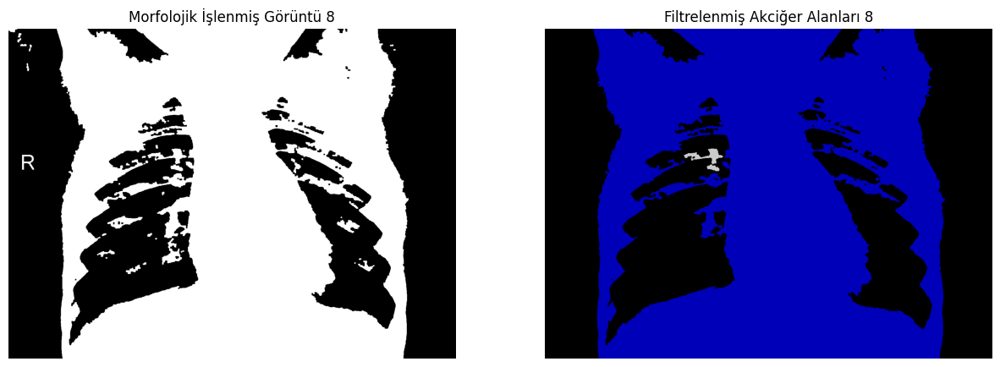

Seçilen Bölgeler: [1, 3]


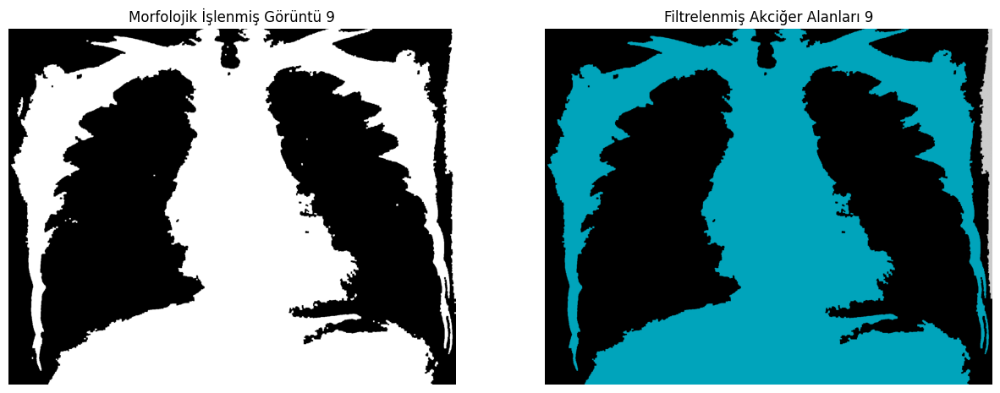

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.measure import regionprops

def filter_regions(region_data):
    """
    Alanlarına göre en büyük iki bölgeyi seçer ve centroid kontrolü yaparak gerekirse üçüncü bölgeyi ekler.
    """
    region_data.sort(key=lambda x: x['area'], reverse=True)
    selected_regions = region_data[:2]

    centroids = np.array([region['centroid'] for region in selected_regions])
    centroid_x, centroid_y = centroids[:, 0], centroids[:, 1]

    # Centroidlerin ortada olup olmadığını kontrol et
    if not (min(centroid_x) < np.mean(centroid_x) < max(centroid_x) and
            min(centroid_y) < np.mean(centroid_y) < max(centroid_y)):
        selected_regions = region_data[:3]

    print(f"Seçilen Bölgeler: {[region['label'] for region in selected_regions]}")
    return selected_regions

def extract_region_data(labels, original_image):
    """
    Bölge özelliklerini çıkararak bir liste halinde döndürür.
    """
    return [{
        'label': region.label,
        'centroid': region.centroid,
        'area': region.area,
        'eccentricity': region.eccentricity,
        'solidity': region.solidity,
        'mean_intensity': region.mean_intensity,
        'orientation': region.orientation
    } for region in regionprops(labels, intensity_image=original_image)]

def connected_components(binary_image):
    """
    Bağlantılı bileşenleri tespit eder.
    """
    return cv2.connectedComponents(binary_image)

def visualize_regions(original, processed, labels, filtered_regions, index):
    """
    Görüntüleri ve işlenen bölgeleri görselleştirir.
    """
    labeled_image = np.zeros_like(labels)
    for region in filtered_regions:
        labeled_image[labels == region['label']] = region['label']

    plt.figure(figsize=(15, 8))

    plt.subplot(1, 2, 1)
    plt.imshow(processed, cmap='gray')
    plt.title(f'Morfolojik İşlenmiş Görüntü {index+1}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(labeled_image, cmap='nipy_spectral')
    plt.title(f'Filtrelenmiş Akciğer Alanları {index+1}')
    plt.axis('off')

    plt.show()

# İşleme başla
for idx, image_path in enumerate(sampled_images[:9]):
    original, _, _, morph_close = apply_morphological_operations(image_path)
    num_labels, labels = connected_components(morph_close)
    region_data = extract_region_data(labels, original)
    filtered_regions = filter_regions(region_data)
    visualize_regions(original, morph_close, labels, filtered_regions, idx)

# Morfolojik İşlem Sonrası Görseller:

Morfolojik işlemlerle akciğer alanlarını belirginleştirme başarılı görünüyor.
Ancak bazı bölgelerde fazladan gürültü kalmış olabilir.
Açma ve kapama (morphological opening & closing) operasyonları bazı yerlerde daha iyi temizlenmiş.
#Bölge Sayısı ve Seçilen Alanlar:

Filtrelenmiş akciğer alanlarında belirli bölgeler iyi ayrılmış.
Akciğer bölgelerinin yoğunluk farkları net şekilde seçilmiş.
Fakat bazı görüntülerde fazla segmentasyon (over-segmentation) görülüyor. Örneğin, bazı bölgeler birden fazla küçük parça olarak ayrılmış.
#Segmentasyon Doğruluğu:

Genel olarak ana akciğer alanları iyi yakalanmış.
Ancak bazı morfolojik işlemler sonucu küçük gürültü noktaları hala mevcut.
Bölge merkezlerine göre en büyük iki bölgenin seçimi genellikle doğru, ancak bazen üçüncü bir bölgenin eklenmesi gerekebiliyor.

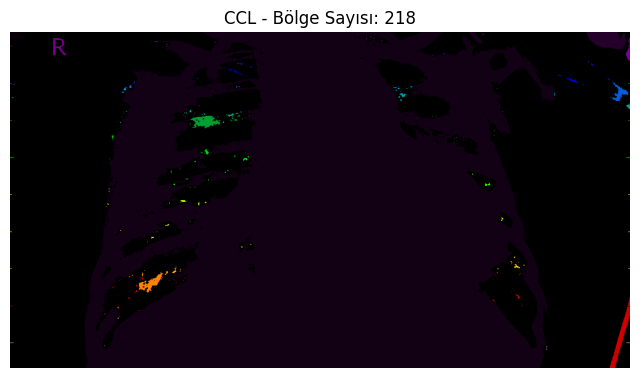


Bölge Sayısı: 218
Filtered Regions (Top by Area & Centroids Check): [2, 4]


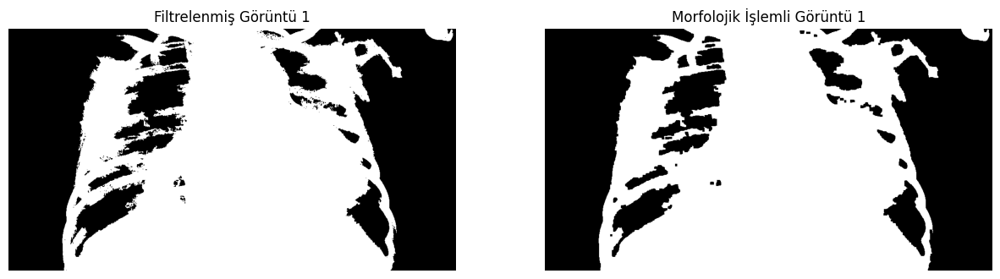

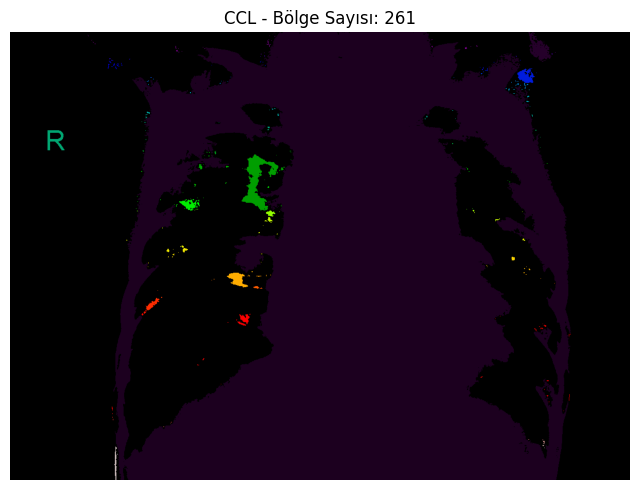


Bölge Sayısı: 261
Filtered Regions (Top by Area & Centroids Check): [4, 120]


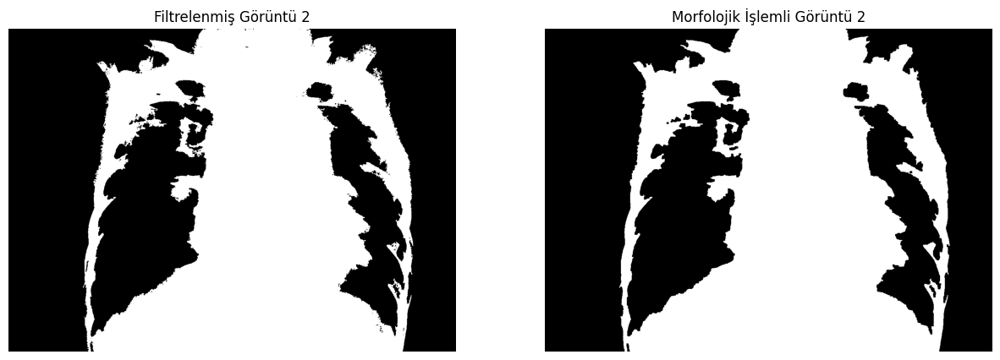

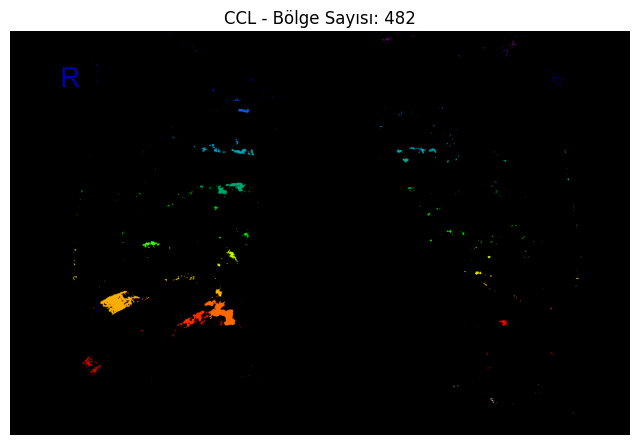


Bölge Sayısı: 482
Filtered Regions (Top by Area & Centroids Check): [1, 376]


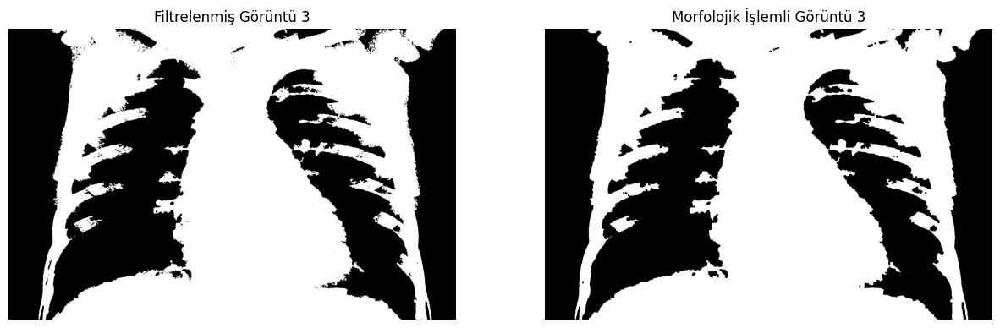

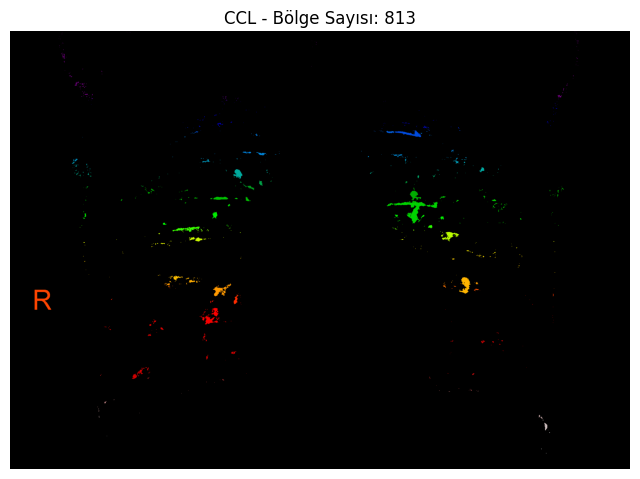


Bölge Sayısı: 813
Filtered Regions (Top by Area & Centroids Check): [2, 435]


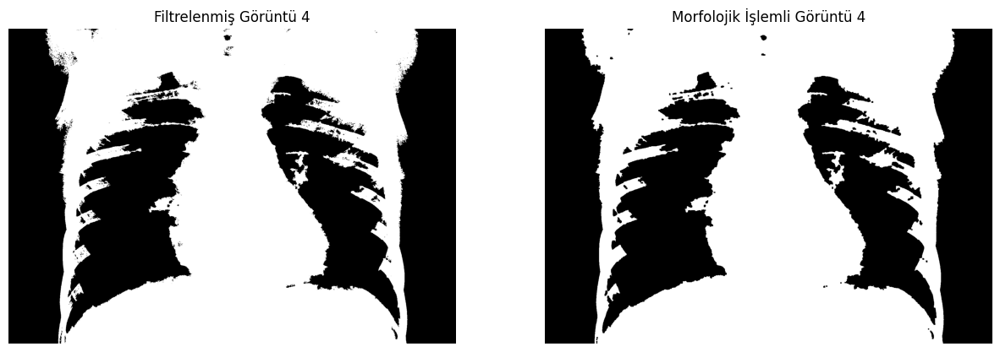

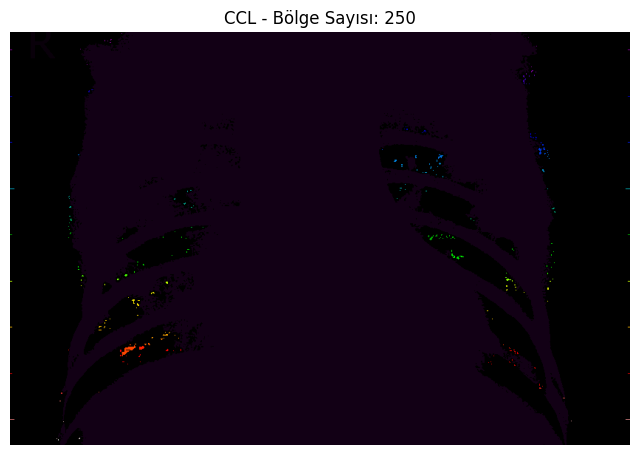


Bölge Sayısı: 250
Filtered Regions (Top by Area & Centroids Check): [2, 1]


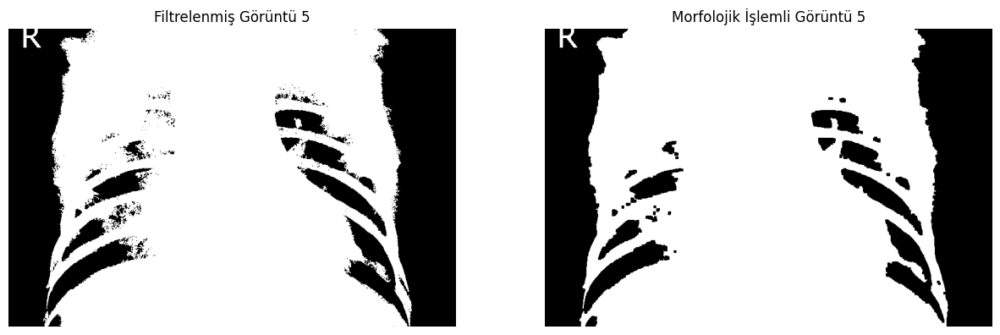

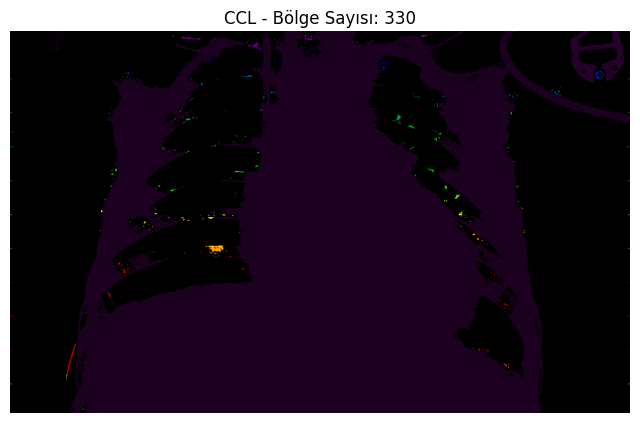


Bölge Sayısı: 330
Filtered Regions (Top by Area & Centroids Check): [4, 6]


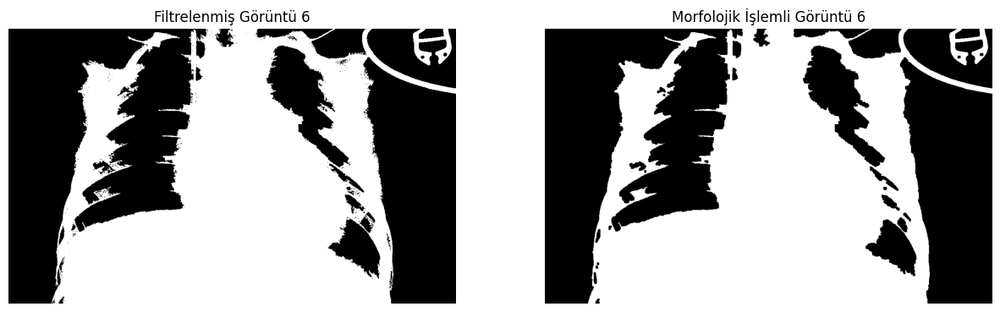

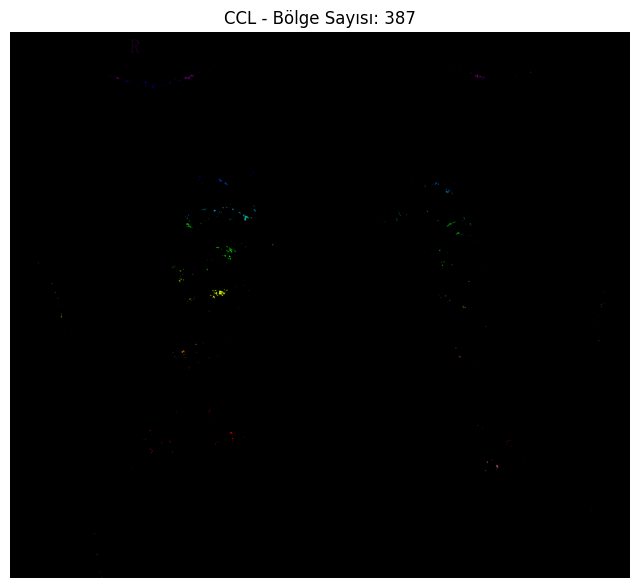


Bölge Sayısı: 387
Filtered Regions (Top by Area & Centroids Check): [1, 5]


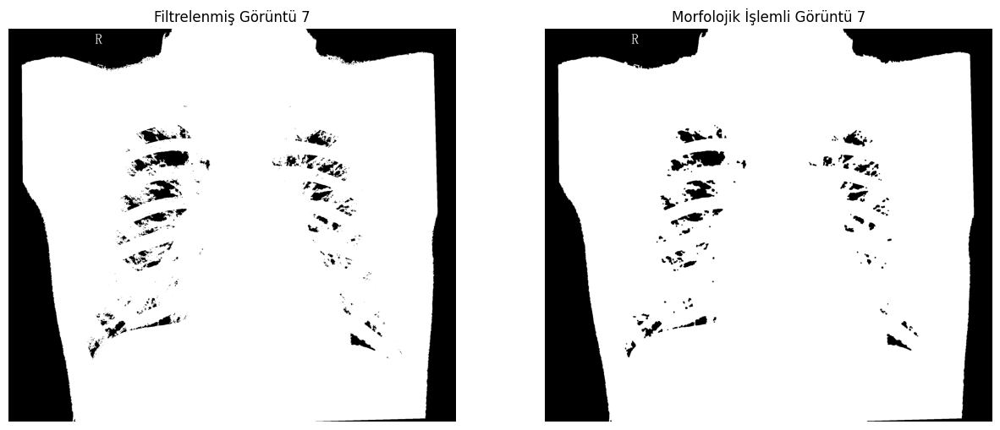

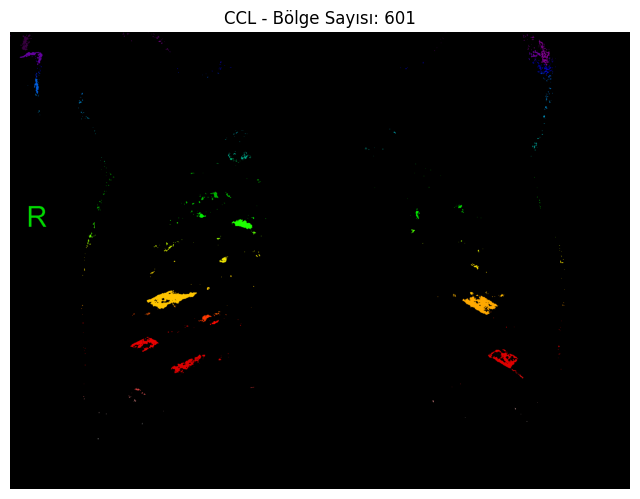


Bölge Sayısı: 601
Filtered Regions (Top by Area & Centroids Check): [2, 454]


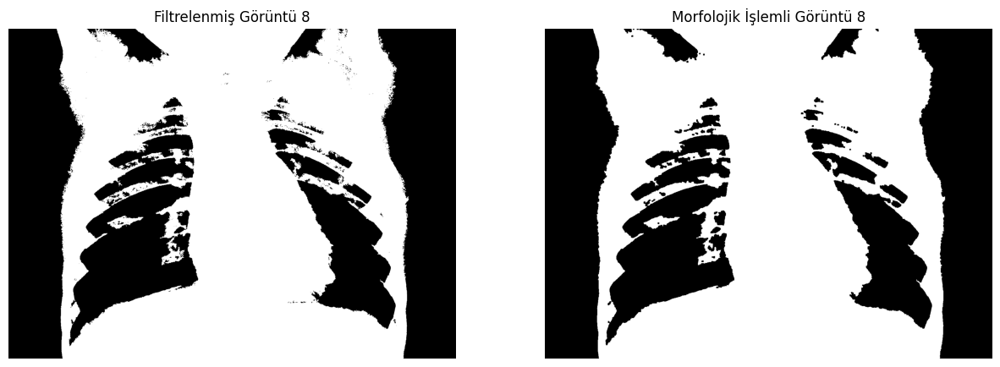

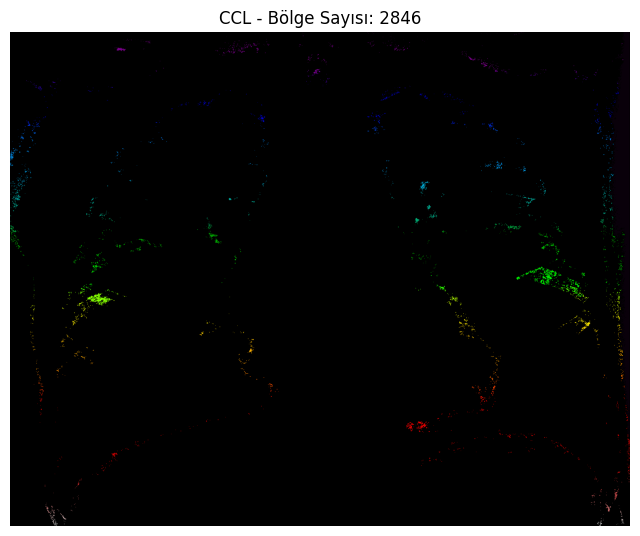


Bölge Sayısı: 2846
Filtered Regions (Top by Area & Centroids Check): [8, 20]


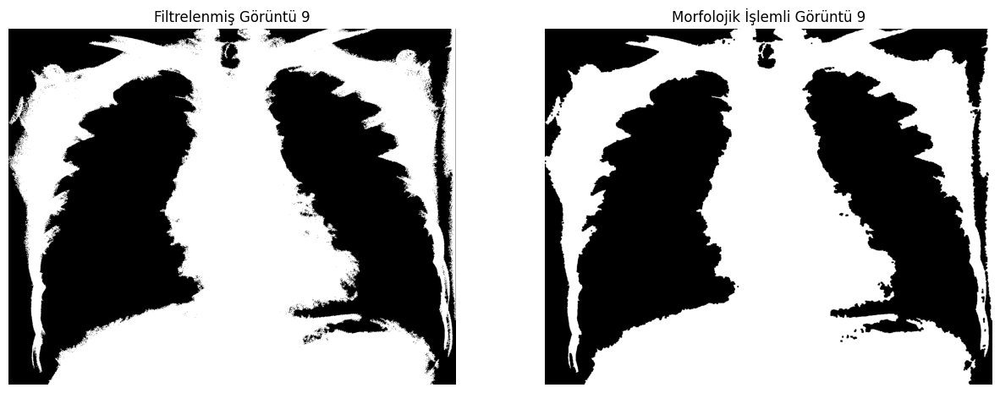

In [ ]:
def apply_morphological_operations(image, kernel_size=(5, 5)):
    """
    Görüntüye morfolojik açma ve kapama işlemleri uygular.
    :param image: İşlenecek ikili (binary) görüntü
    :param kernel_size: Kullanılacak çekirdek (kernel) boyutu
    :return: Açma ve kapama işlemi uygulanmış görüntüler
    """
    kernel = np.ones(kernel_size, np.uint8)
    morph_open = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    morph_close = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    return morph_open, morph_close

# Örnek görüntüleri işle
for idx, image_path in enumerate(sampled_images[:9]):
    original_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

    # Otsu eşikleme ile ikili (binary) görüntü elde etme
    _, binary_otsu = cv2.threshold(original_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Bölge tabanlı filtreleme işlemleri
    filtered_image = np.zeros_like(binary_otsu)
    num_labels, labels, *_ = connected_components_analysis(binary_otsu, original_image)
    region_data = extract_region_properties(labels, original_image)
    filtered_regions = filter_regions_by_area_and_centroid(region_data)

    for region in filtered_regions:
        filtered_image[labels == region['label']] = 255

    # Morfolojik işlemleri uygula
    morph_open_filtered, morph_close_filtered = apply_morphological_operations(filtered_image)

    # Görüntüleri görselleştir
    fig, axes = plt.subplots(1, 2, figsize=(15, 8))

    axes[0].imshow(filtered_image, cmap='gray')
    axes[0].set_title(f'Filtrelenmiş Görüntü {idx+1}')
    axes[0].axis('off')

    axes[1].imshow(morph_close_filtered, cmap='gray')
    axes[1].set_title(f'Morfolojik İşlemli Görüntü {idx+1}')
    axes[1].axis('off')

    plt.show()

# Bölge Sayısı ve Dağılımı:

Görüntülerin üst kısmındaki etiketlerden, segmentasyon sonrası bağlantılı bileşen analizi (CCL - Connected Component Labeling) ile tespit edilen bölge sayıları belirtilmiş.
Bazı görüntülerde bölge sayısının oldukça yüksek olduğu (örneğin 813 bölge) ve bazılarında daha düşük olduğu (218 bölge) gözlemleniyor.
Bölge sayısının fazla olması, segmentasyonun çok küçük ayrıntıları bölge olarak kabul ettiğini ve bunun muhtemelen daha fazla gürültü (noise) içerdiğini gösteriyor.
# Morfolojik İşlemler ve Filtreleme:

Morfolojik açma ve kapama (morphological opening & closing) işlemleri kullanılarak segmentasyonun iyileştirilmesine çalışılmış.
Görsellerin sol tarafındaki "Filtrelenmiş Görüntü" ve sağ tarafındaki "Morfolojik İşlemli Görüntü" karşılaştırıldığında, gürültünün bir miktar azaldığı ancak hala bazı küçük bölgelerin mevcut olduğu görülüyor.
# Akciğer Alanlarının Belirlenmesi:

Segmentasyon sonrası belirlenen akciğer alanlarının görsellerin sağ tarafında farklı renklerle gösterildiği görülüyor.
Ancak bazı görüntülerde yanlış bölgelerin de akciğer olarak sınıflandırıldığı fark ediliyor.
Özellikle kaburgalar ve diğer anatomik yapılar yanlışlıkla segmentasyona dahil ediliyor. Bu durum, segmentasyon algoritmasının daha iyi filtreleme veya maskelenmiş bir bölgesel analiz gerektirdiğini gösteriyor.
# Segmentasyonun Başarısı:

Görsellerin genelinde akciğer bölgelerinin büyük oranda doğru şekilde ayrıştırıldığı söylenebilir.
Ancak yanlış pozitif bölgeler hala mevcut. Özellikle kaburgalar ve bazı iç organ bölümleri yanlışlıkla akciğer dokusuyla karışabiliyor.
Filtreleme sonrası daha belirgin akciğer segmentleri elde edilmesine rağmen, daha fazla ince ayar yapılması gerekebilir.

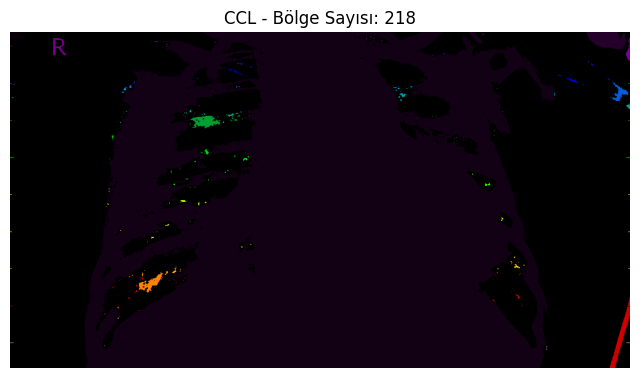


Bölge Sayısı: 218
Filtered Regions (Top by Area & Centroids Check): [2, 4]


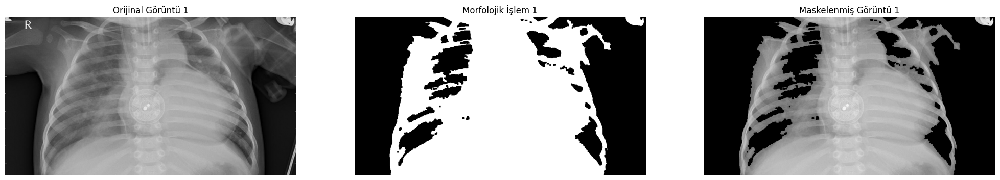

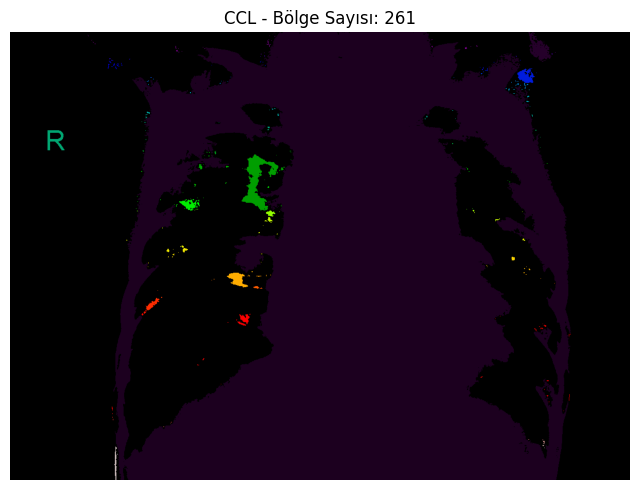


Bölge Sayısı: 261
Filtered Regions (Top by Area & Centroids Check): [4, 120]


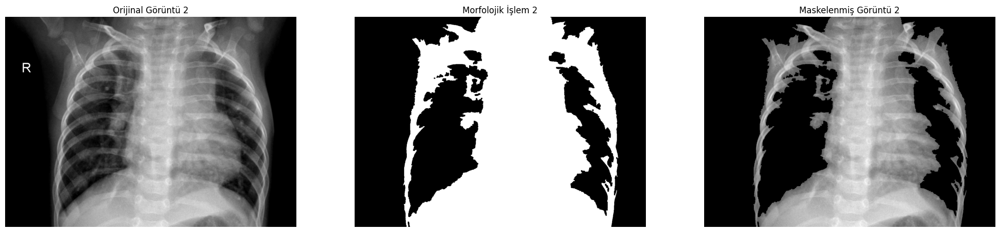

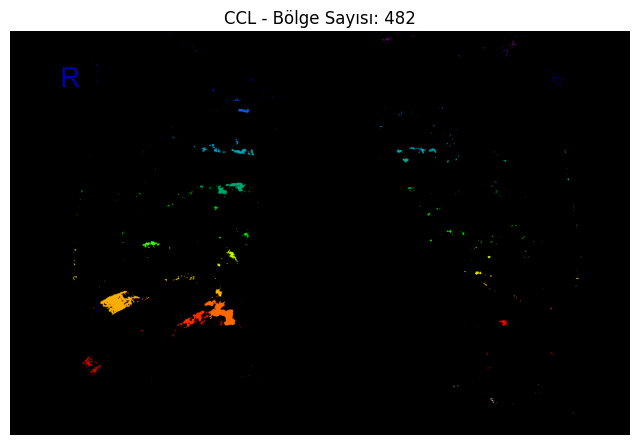


Bölge Sayısı: 482
Filtered Regions (Top by Area & Centroids Check): [1, 376]


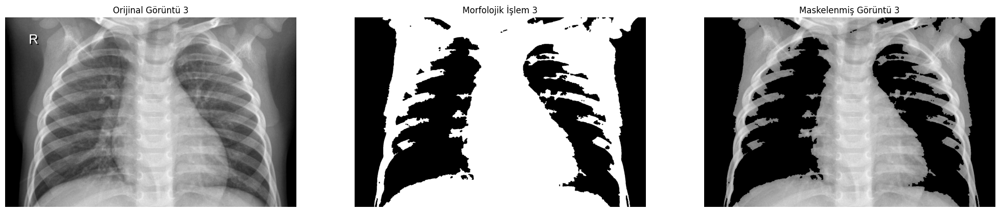

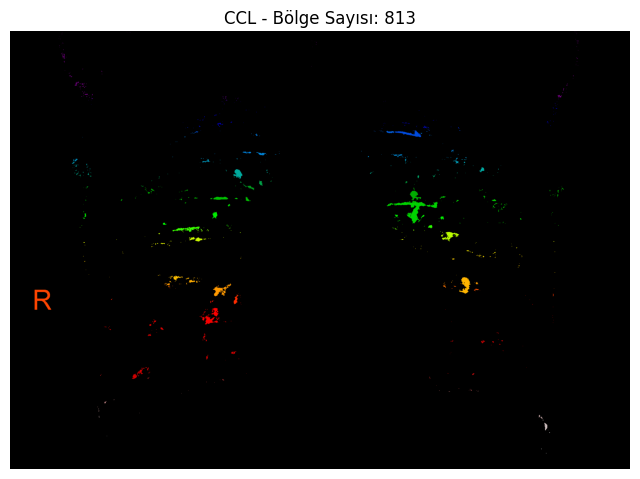


Bölge Sayısı: 813
Filtered Regions (Top by Area & Centroids Check): [2, 435]


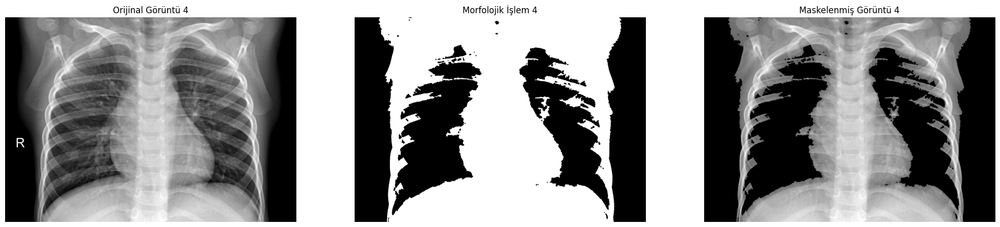

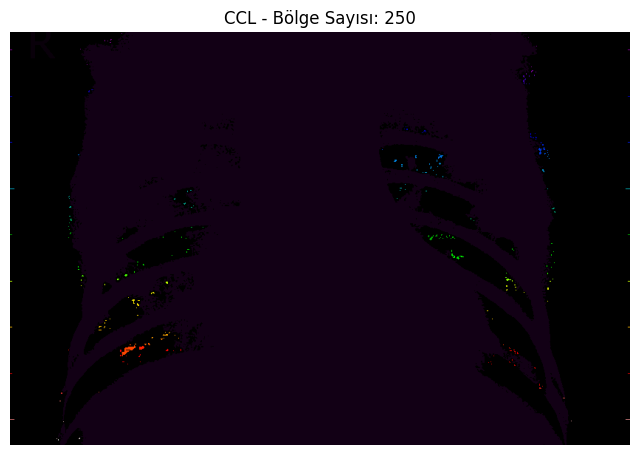


Bölge Sayısı: 250
Filtered Regions (Top by Area & Centroids Check): [2, 1]


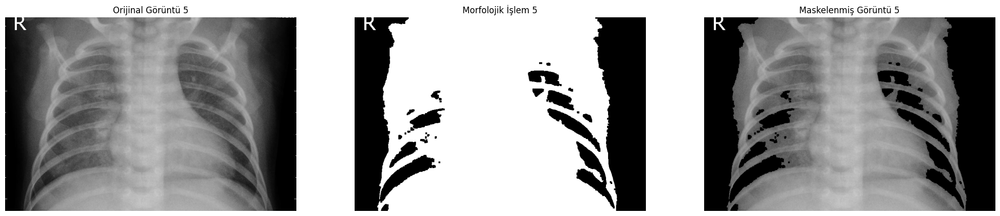

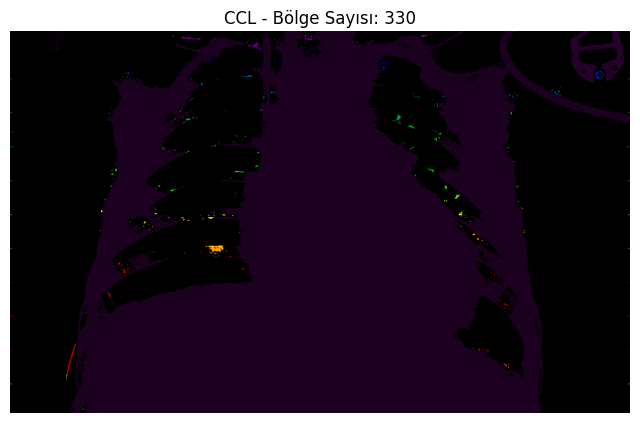


Bölge Sayısı: 330
Filtered Regions (Top by Area & Centroids Check): [4, 6]


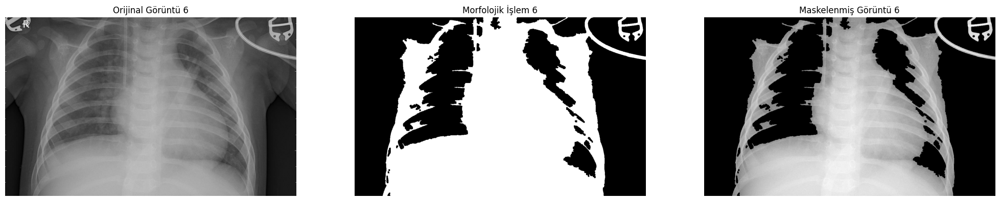

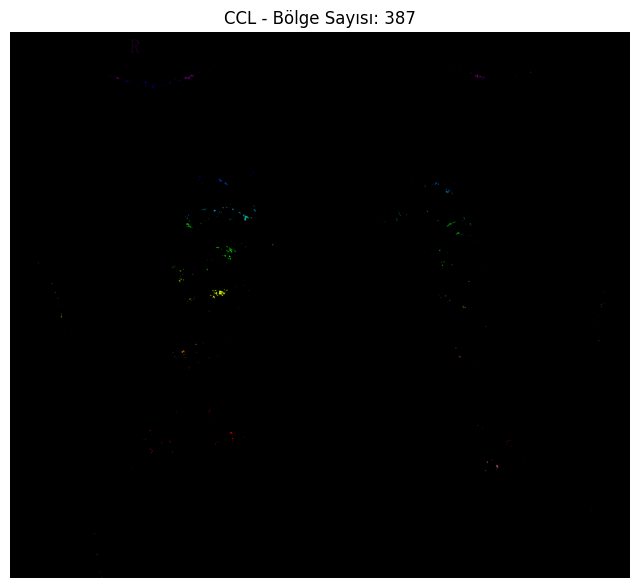


Bölge Sayısı: 387
Filtered Regions (Top by Area & Centroids Check): [1, 5]


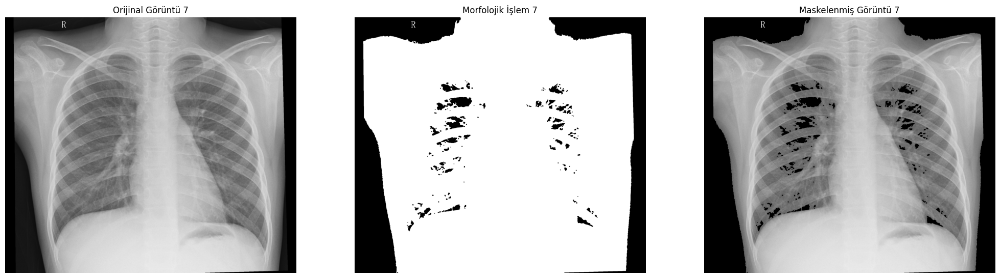

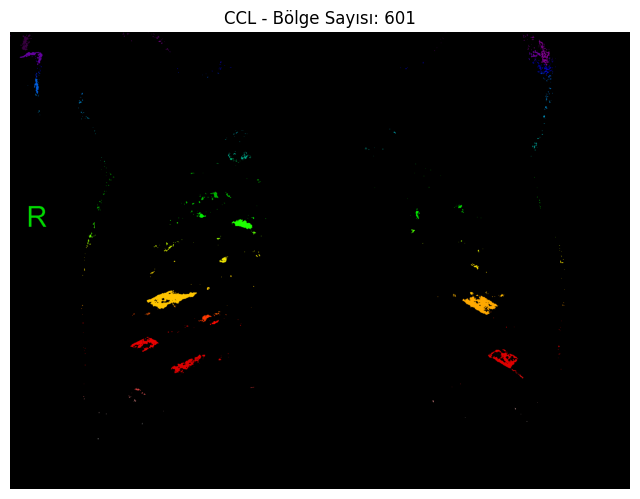


Bölge Sayısı: 601
Filtered Regions (Top by Area & Centroids Check): [2, 454]


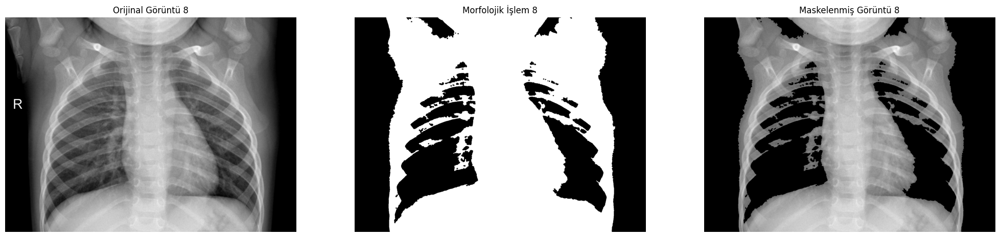

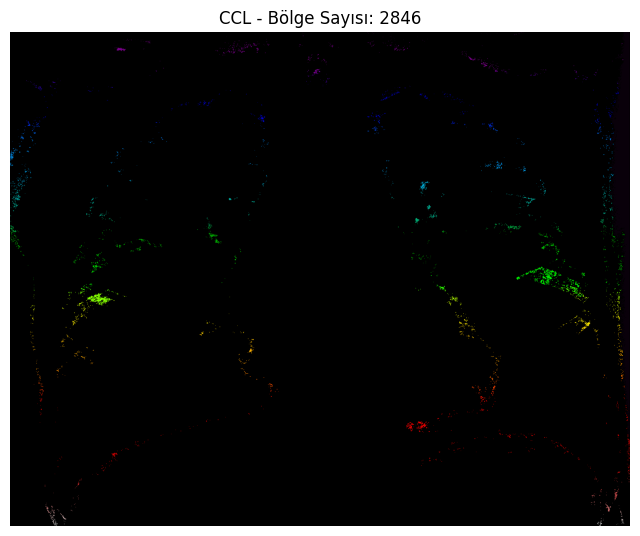


Bölge Sayısı: 2846
Filtered Regions (Top by Area & Centroids Check): [8, 20]


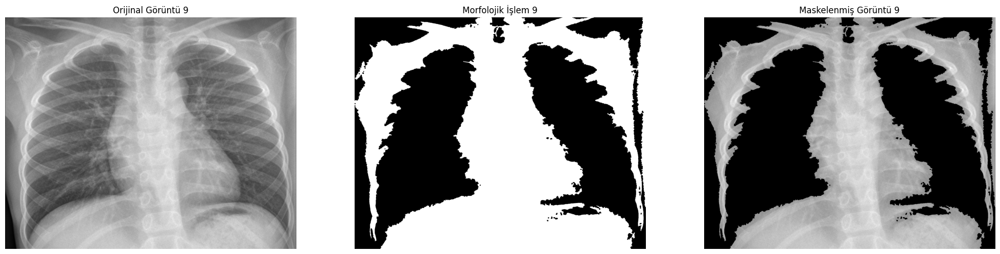

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def apply_morph_operations(image, kernel_size=(5, 5)):
    kernel = np.ones(kernel_size, np.uint8)

    # Açma ve Kapama işlemleri
    opened = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    closed = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)

    return opened, closed

for idx, img_path in enumerate(sampled_images[:9]):
    # Görüntüyü gri tonlamalı olarak yükle
    img_gray = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    # Otsu Thresholding ile binary görüntü elde et
    _, binary_img = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Bağlı bileşen analizi uygulama
    filtered_img = np.zeros_like(binary_img)
    num_labels, labels, *_ = connected_components_analysis(binary_img, img_gray)
    regions = extract_region_properties(labels, img_gray)
    selected_regions = filter_regions_by_area_and_centroid(regions)

    # Seçili bölgeleri yeni görüntüye ekleme
    for region in selected_regions:
        filtered_img[labels == region['label']] = 255

    # Morfolojik işlemler
    opened_img, closed_img = apply_morph_operations(filtered_img)

    # Maskelenmiş görüntü elde et
    masked_result = cv2.bitwise_and(img_gray, img_gray, mask=closed_img)

    # Görüntüleri çizdir
    plt.figure(figsize=(25, 15))

    plt.subplot(1, 3, 1)
    plt.imshow(img_gray, cmap='gray')
    plt.title(f'Orijinal Görüntü {idx+1}')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(closed_img, cmap='gray')
    plt.title(f'Morfolojik İşlem {idx+1}')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(masked_result, cmap='gray')
    plt.title(f'Maskelenmiş Görüntü {idx+1}')
    plt.axis('off')

    plt.show()

# Segmentasyon Doğruluğu
Genel olarak başarılı bir segmentasyon var. Akciğer alanları net şekilde ayrılmış.
Morfolojik işlemler (açma/kapama) bazı artefaktları temizlemiş ancak kenarlarda hala gürültü mevcut olabilir.
Otsu eşikleme yöntemi segmentasyon için iyi bir başlangıç noktası olmuş ancak bazı bölgelerde fazla agresif olabilir.
# Bölge Sayısı ve Odaklanma
Bağlı bileşen analizinde 218, 261, 482, 813, 250 gibi farklı bölge sayıları tespit edilmiş.
Özellikle 482 ve 813 bölge içeren görüntülerde fazla parçalanma olmuş. Bu, segmentasyonun bazı küçük gürültü noktalarını da bölge olarak algıladığını gösteriyor.
En büyük iki ya da üç bölgeyi seçme stratejisi oldukça mantıklı. Ancak fazla bölge olması segmentasyonun fazla ayrıntılı olabileceğini gösteriyor.
# Maskelenmiş Görüntülerin Etkinliği
Maskelenmiş görüntülerde akciğer bölgeleri genellikle başarılı şekilde ayrılmış.
Kenar bölgelerde fazla siyah alan kalması, bazı bilgilerin kaybolmasına neden olabilir.
Daha iyi sonuç almak için kenar düzeltme veya kontur iyileştirme uygulanabilir.